# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [10]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [11]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [12]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [13]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [16]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes 
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [17]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [18]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.2186510630846024, discriminator loss: 0.28312313520163296


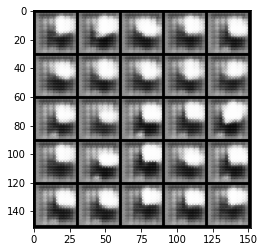

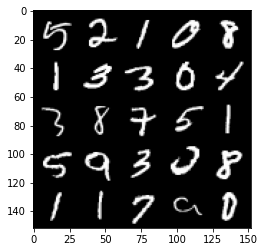

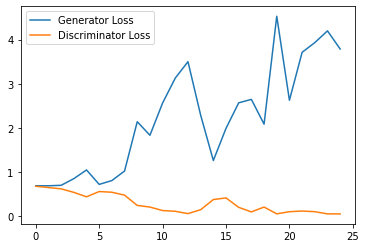

Step 1000: Generator loss: 3.954350908279419, discriminator loss: 0.08413995531946421


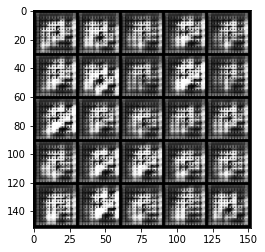

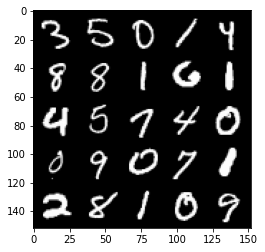

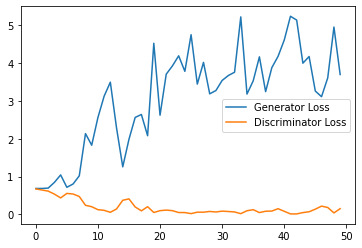

Step 1500: Generator loss: 4.468009392738343, discriminator loss: 0.07029765494726599


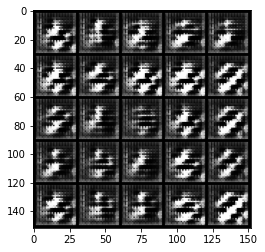

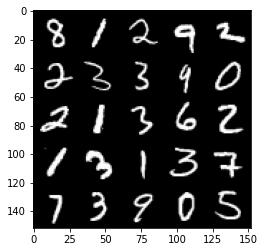

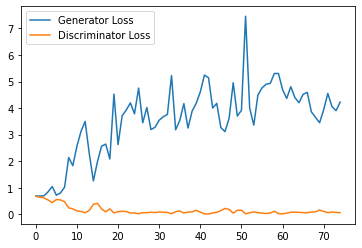

Step 2000: Generator loss: 3.5893996014595033, discriminator loss: 0.09646856533363461


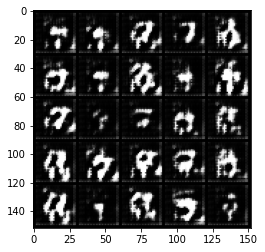

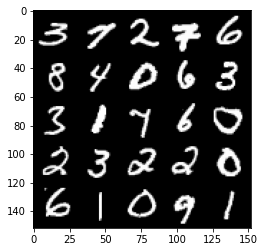

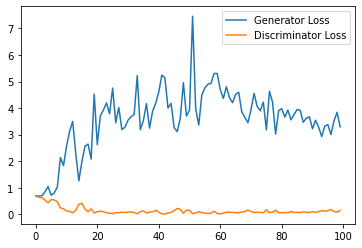

Step 2500: Generator loss: 2.758958995103836, discriminator loss: 0.20931546687334776


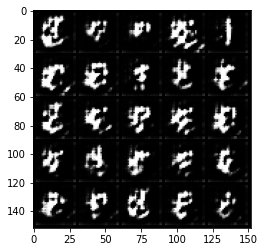

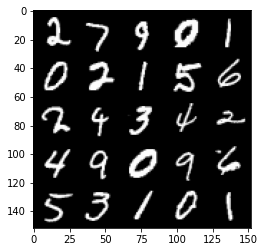

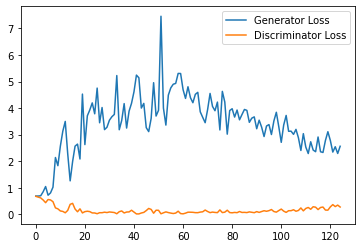

Step 3000: Generator loss: 2.347187095403671, discriminator loss: 0.2872434122115374


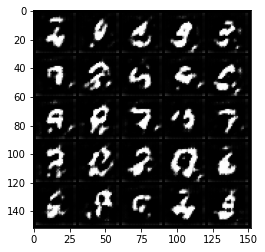

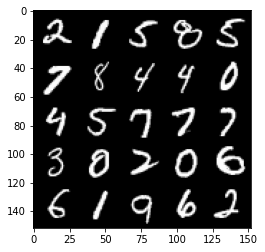

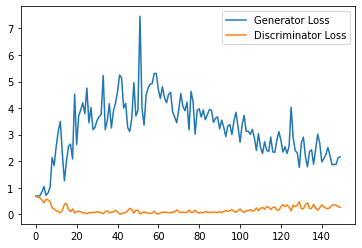

Step 3500: Generator loss: 2.3064938914775848, discriminator loss: 0.30545749828219415


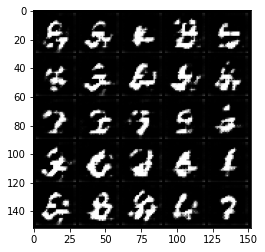

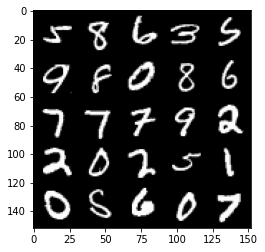

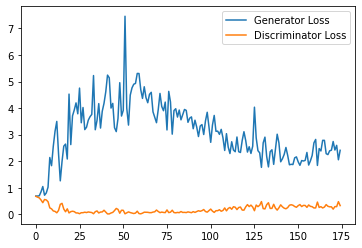

Step 4000: Generator loss: 2.249347837924957, discriminator loss: 0.30509229290485385


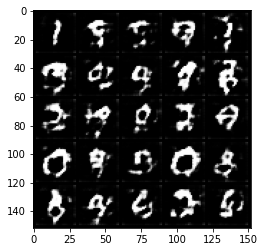

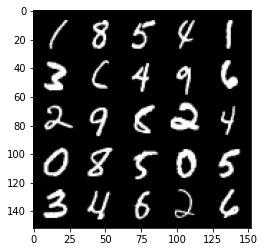

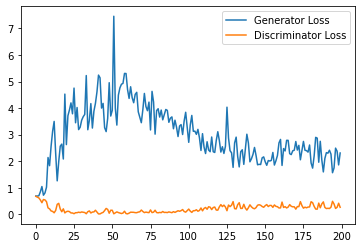

Step 4500: Generator loss: 2.0453004758358, discriminator loss: 0.3306302776634693


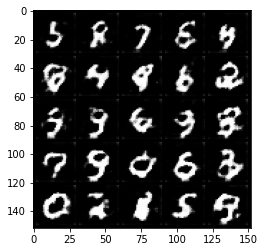

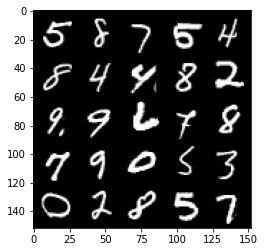

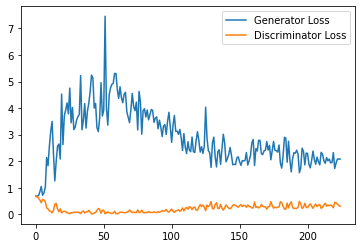

Step 5000: Generator loss: 1.854932601928711, discriminator loss: 0.35524695497751235


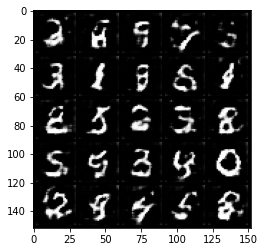

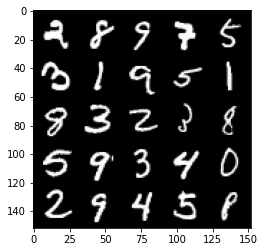

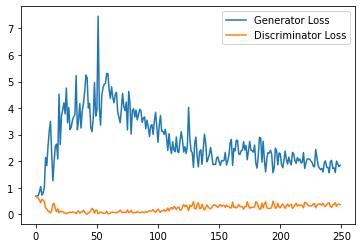

Step 5500: Generator loss: 1.7893131563663482, discriminator loss: 0.4131460292339325


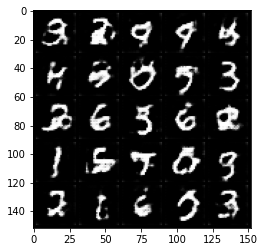

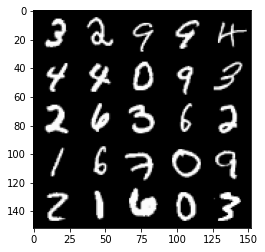

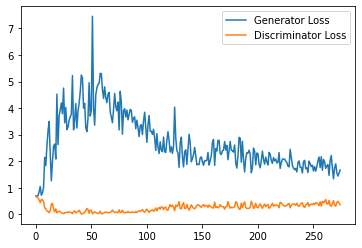

Step 6000: Generator loss: 1.6508053951263428, discriminator loss: 0.4056154638826847


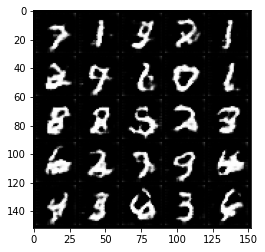

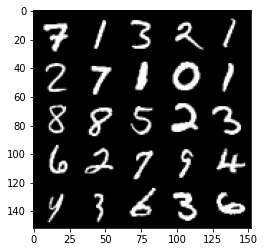

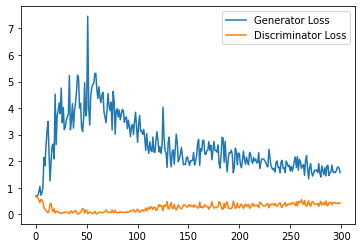

Step 6500: Generator loss: 1.6705174489021302, discriminator loss: 0.4268094955086708


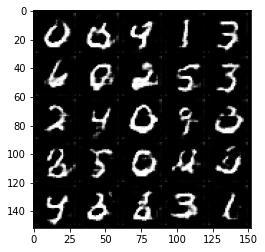

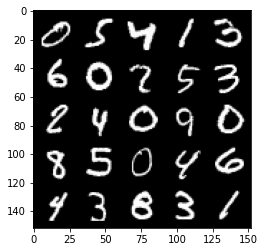

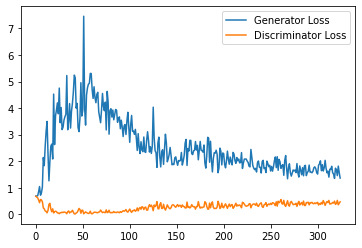

Step 7000: Generator loss: 1.5189277094602585, discriminator loss: 0.4501186230480671


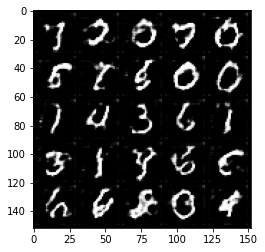

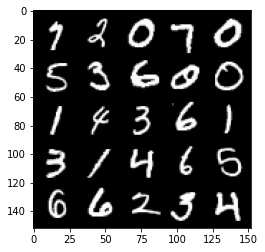

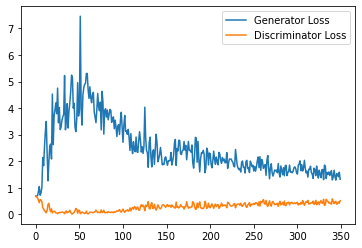

Step 7500: Generator loss: 1.373548749089241, discriminator loss: 0.4745558829307556


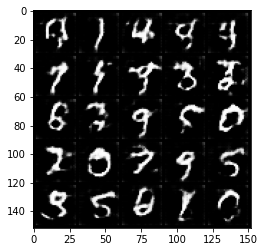

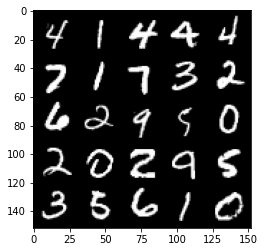

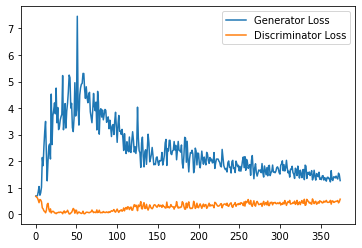

Step 8000: Generator loss: 1.3967903876304626, discriminator loss: 0.5004009920358657


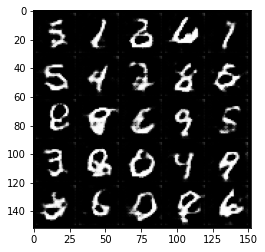

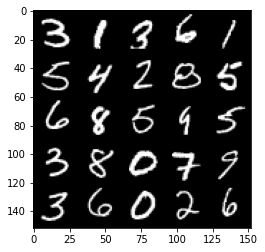

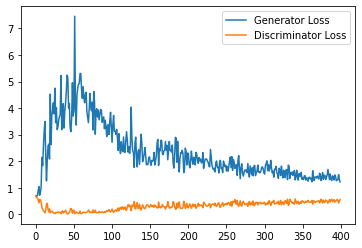

Step 8500: Generator loss: 1.3014289237260819, discriminator loss: 0.513392338514328


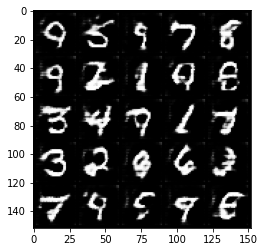

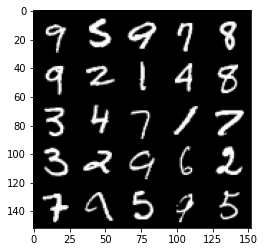

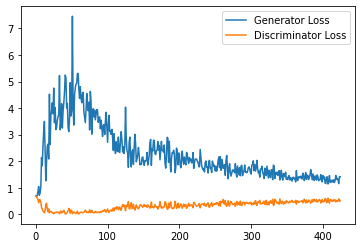

Step 9000: Generator loss: 1.3224384002685547, discriminator loss: 0.5281695024371147


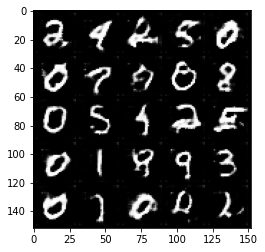

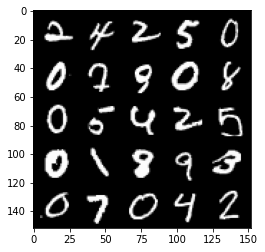

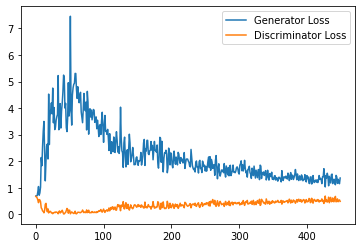

Step 9500: Generator loss: 1.19841925740242, discriminator loss: 0.54407833725214


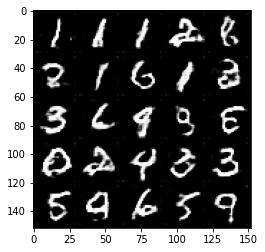

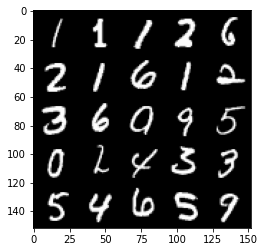

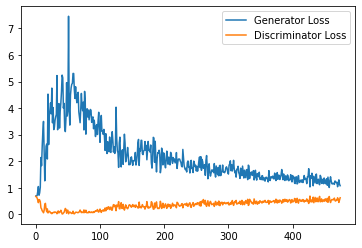

Step 10000: Generator loss: 1.2283314609527587, discriminator loss: 0.5482223240137101


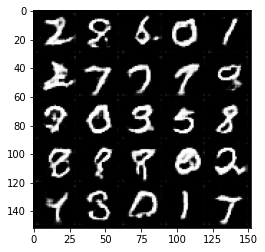

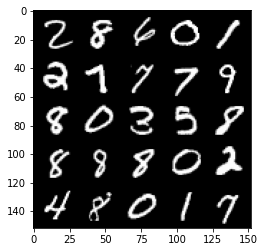

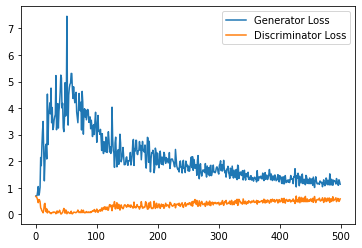

Step 10500: Generator loss: 1.2322096070051194, discriminator loss: 0.5543678444623947


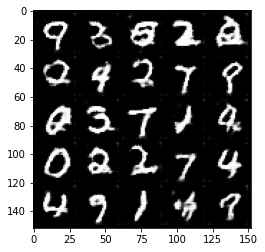

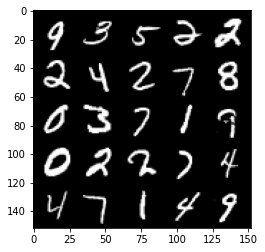

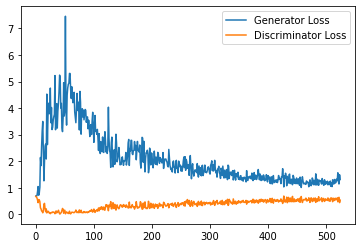

Step 11000: Generator loss: 1.1562330883741379, discriminator loss: 0.5600348535776138


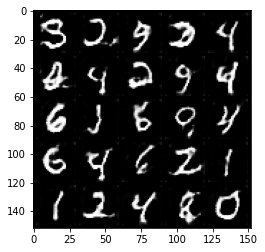

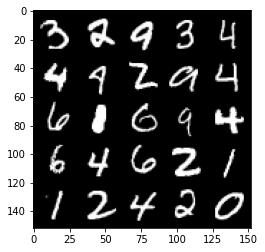

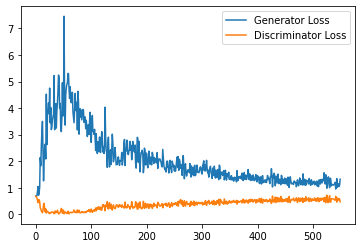

Step 11500: Generator loss: 1.1007571941614152, discriminator loss: 0.5711062053442001


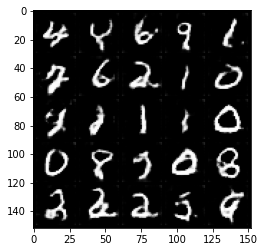

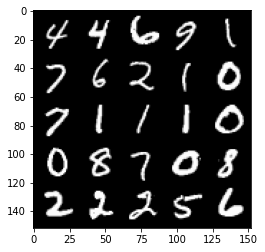

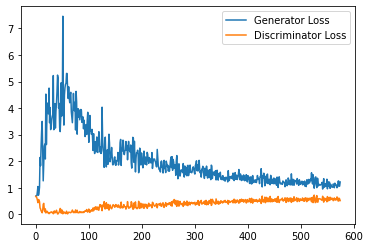

Step 12000: Generator loss: 1.1570326060056686, discriminator loss: 0.5729923901557923


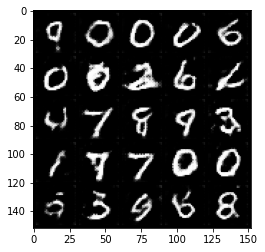

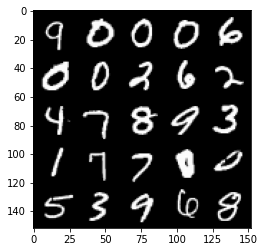

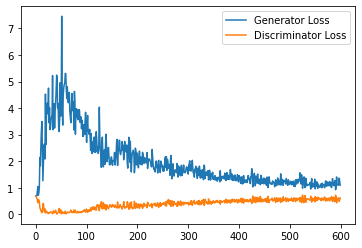

Step 12500: Generator loss: 1.1293896732330322, discriminator loss: 0.5696124346852303


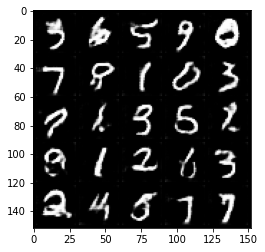

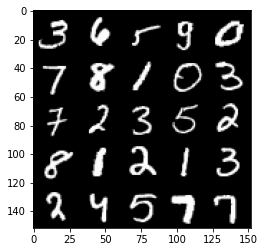

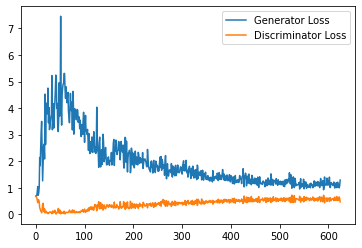

Step 13000: Generator loss: 1.114516101837158, discriminator loss: 0.5833115907907486


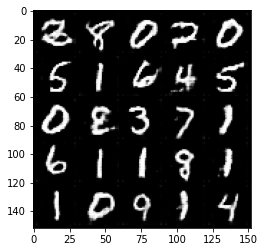

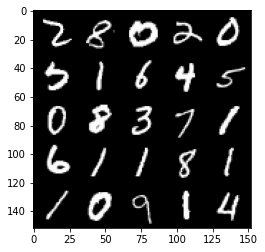

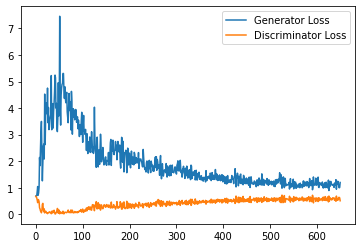

Step 13500: Generator loss: 1.0700772253274917, discriminator loss: 0.5866031844615937


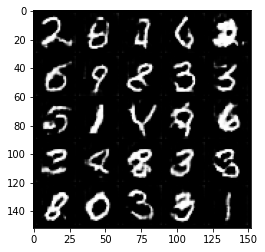

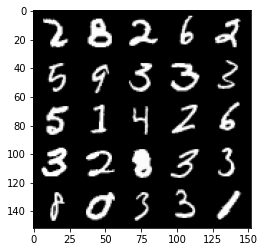

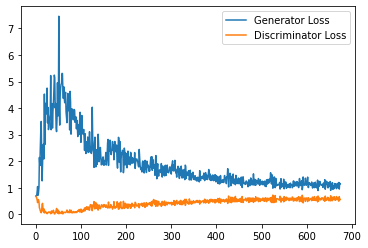

Step 14000: Generator loss: 1.090620322227478, discriminator loss: 0.58425197660923


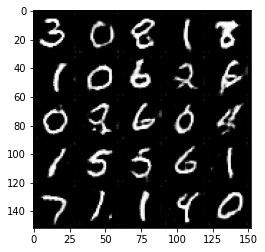

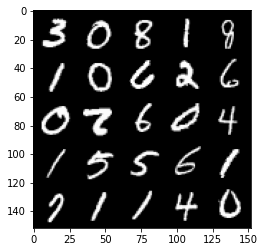

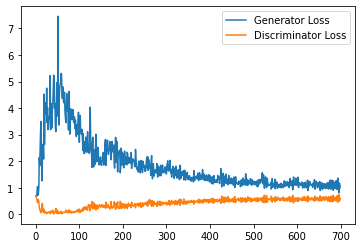

Step 14500: Generator loss: 1.024542502641678, discriminator loss: 0.5961273331642151


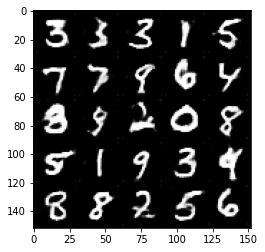

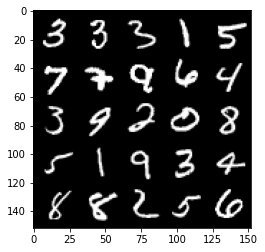

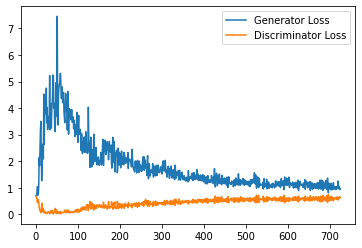

Step 15000: Generator loss: 1.0329879194498062, discriminator loss: 0.5916109362840652


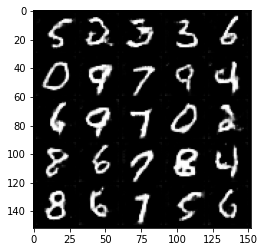

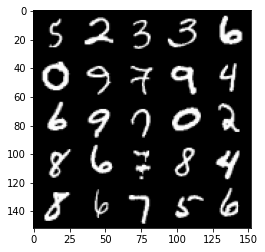

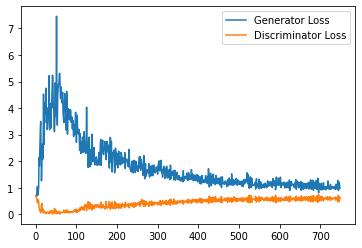

Step 15500: Generator loss: 1.0266422512531281, discriminator loss: 0.6072296841740609


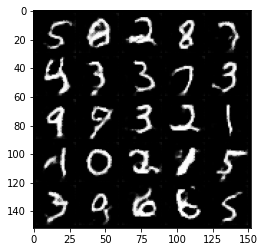

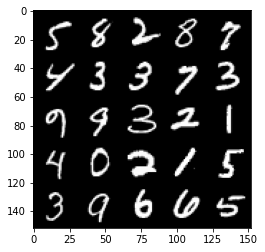

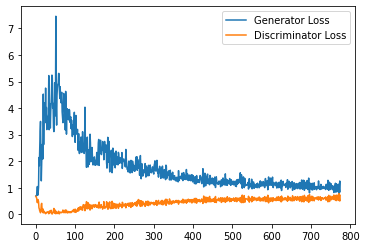

Step 16000: Generator loss: 1.0299777166843413, discriminator loss: 0.5968856909871101


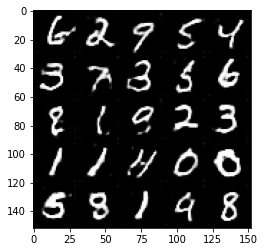

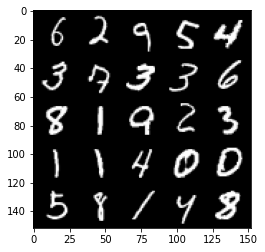

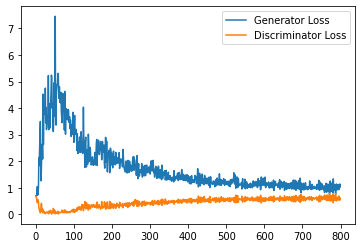

Step 16500: Generator loss: 1.0124560021162032, discriminator loss: 0.6075305383205414


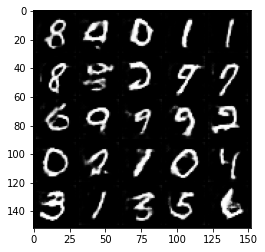

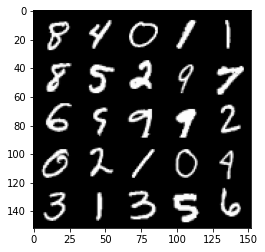

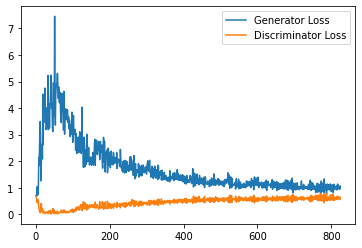

Step 17000: Generator loss: 1.040342607498169, discriminator loss: 0.607620905160904


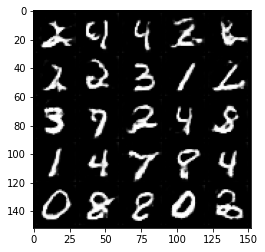

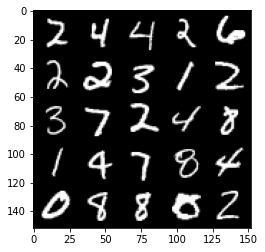

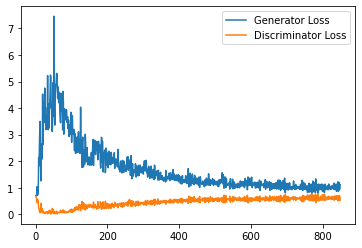

Step 17500: Generator loss: 0.9842651678323746, discriminator loss: 0.6147876117229462


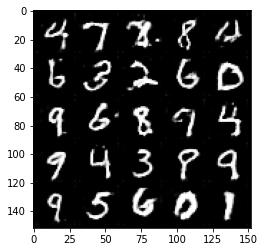

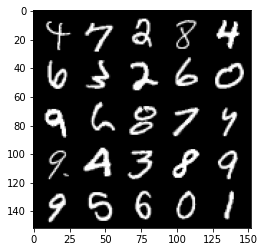

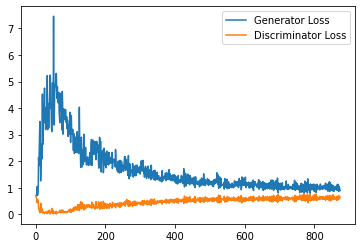

Step 18000: Generator loss: 0.9792994344234467, discriminator loss: 0.6131198348402978


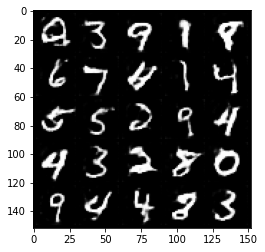

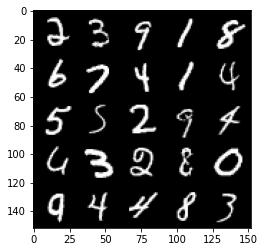

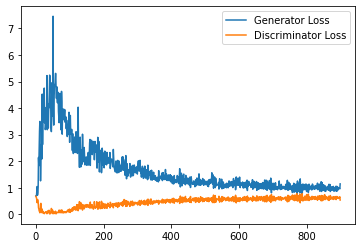

Step 18500: Generator loss: 0.9690084450244904, discriminator loss: 0.6157627747058868


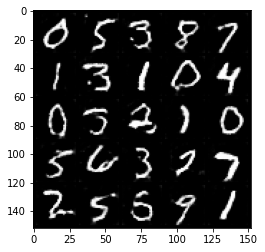

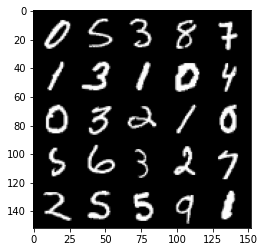

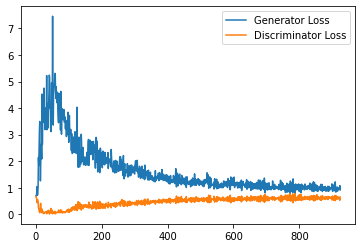

Step 19000: Generator loss: 1.0232192620038987, discriminator loss: 0.6147636551856994


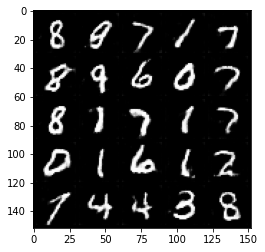

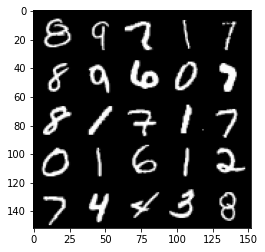

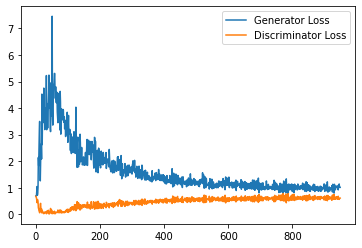

Step 19500: Generator loss: 0.9674854327440262, discriminator loss: 0.6152199461460114


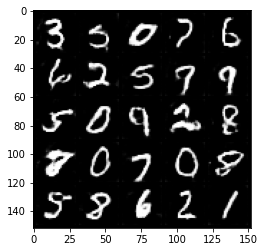

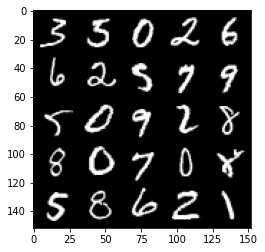

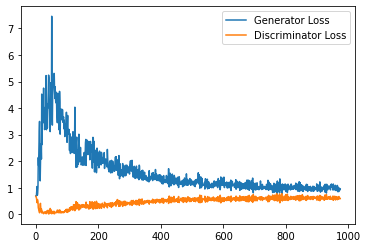

Step 20000: Generator loss: 0.939624990940094, discriminator loss: 0.6157734780907631


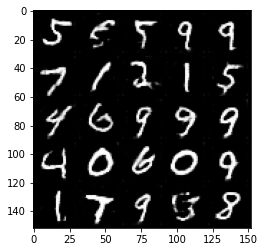

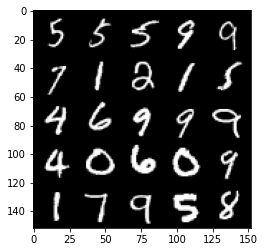

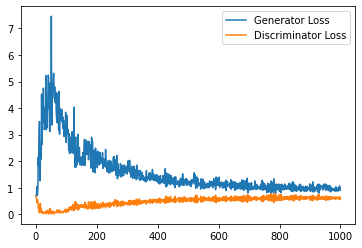

Step 20500: Generator loss: 0.9492383821010589, discriminator loss: 0.6149940149188041


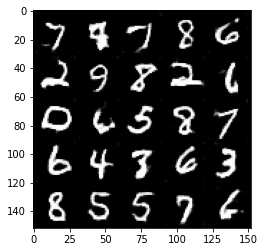

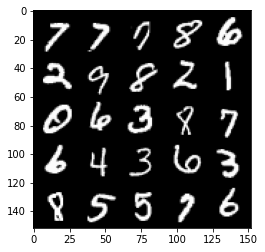

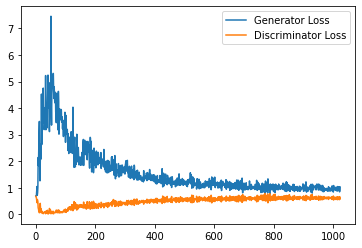

Step 21000: Generator loss: 0.9494845548868179, discriminator loss: 0.6182877400517464


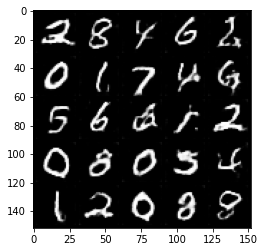

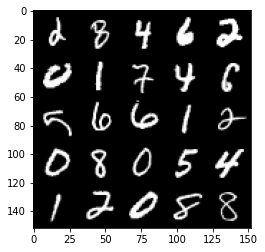

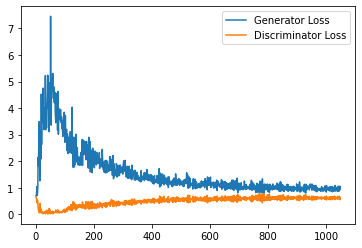

Step 21500: Generator loss: 0.9418718793392181, discriminator loss: 0.6199692121148109


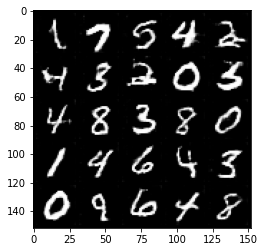

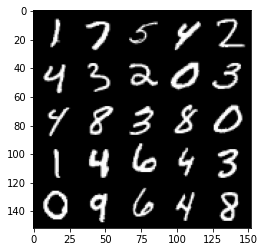

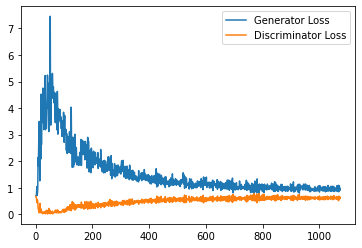

Step 22000: Generator loss: 0.9677466489076615, discriminator loss: 0.6182972077131271


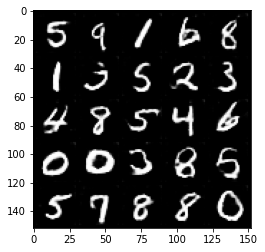

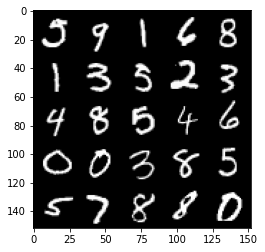

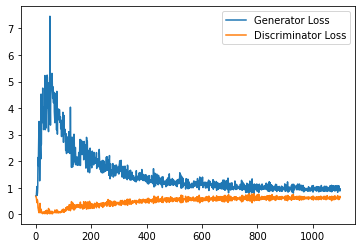

Step 22500: Generator loss: 0.9243740432262421, discriminator loss: 0.6207491332292556


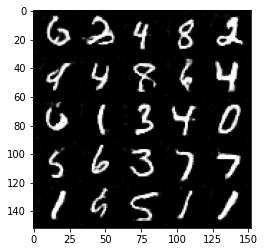

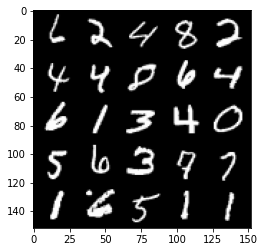

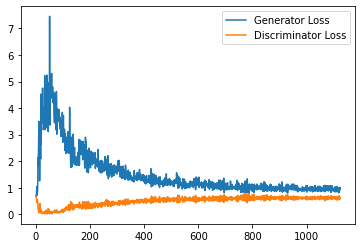

Step 23000: Generator loss: 0.9342328885793686, discriminator loss: 0.6219150322675705


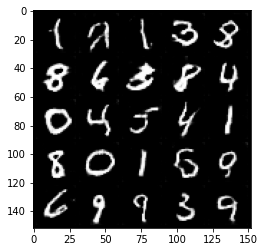

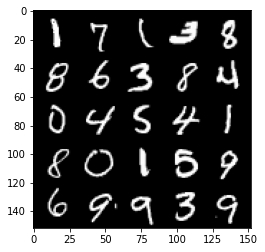

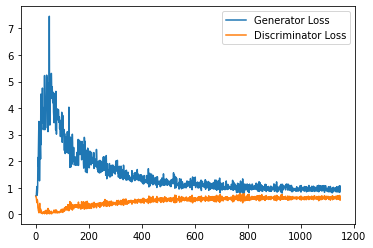

Step 23500: Generator loss: 0.9327788752317429, discriminator loss: 0.6212306502461433


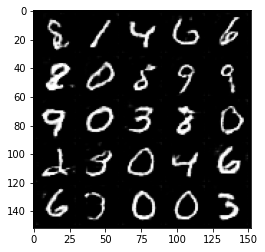

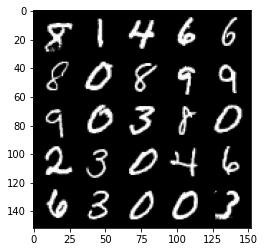

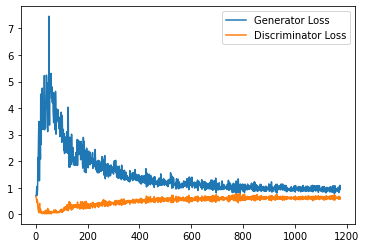

Step 24000: Generator loss: 0.9625903010368347, discriminator loss: 0.622566573023796


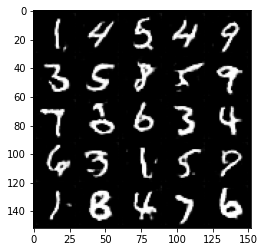

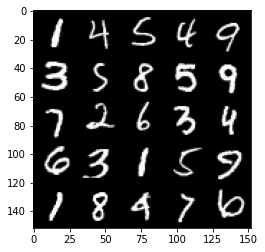

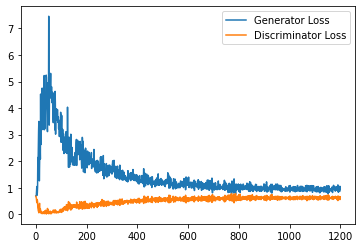

Step 24500: Generator loss: 0.9424254064559936, discriminator loss: 0.621597168803215


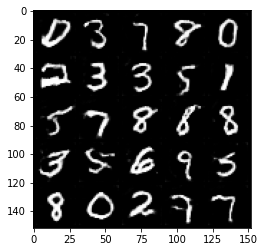

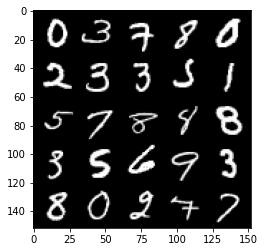

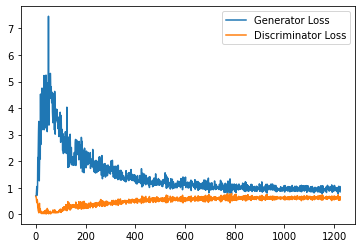

Step 25000: Generator loss: 0.9284355880022049, discriminator loss: 0.6254269785284996


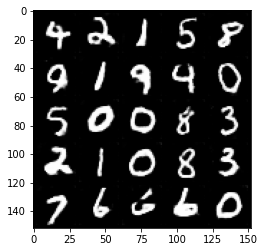

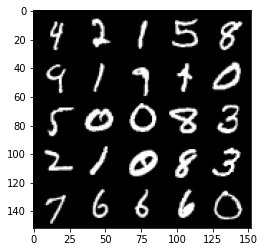

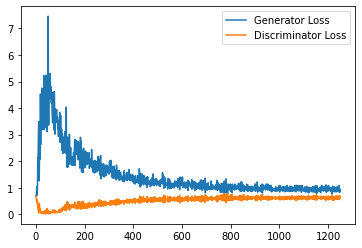

Step 25500: Generator loss: 0.9403677912950515, discriminator loss: 0.6280810683965683


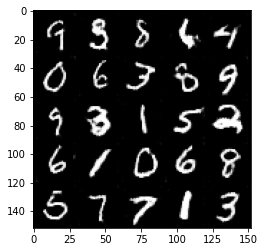

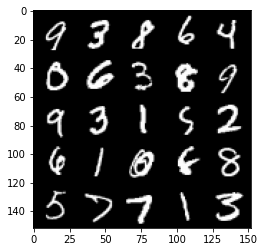

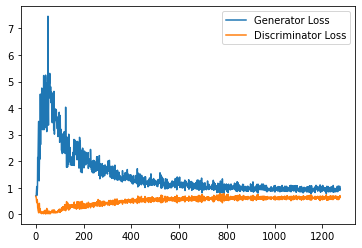

Step 26000: Generator loss: 0.9322161551713943, discriminator loss: 0.6170771970152855


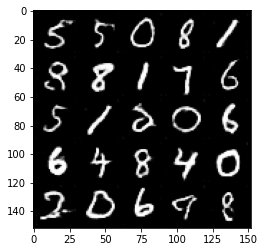

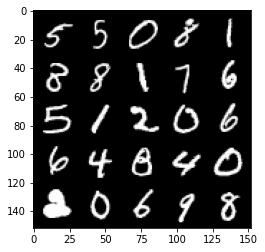

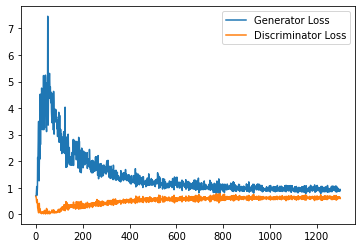

Step 26500: Generator loss: 0.9063292373418808, discriminator loss: 0.626288946390152


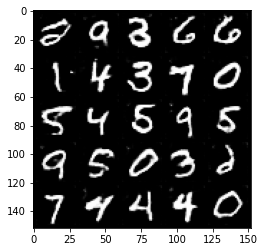

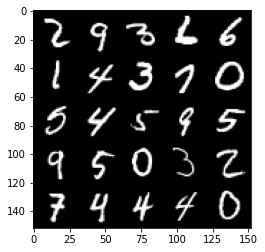

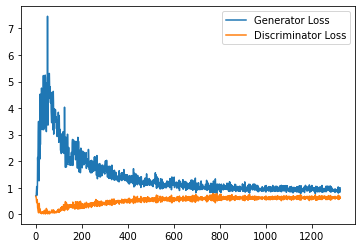

Step 27000: Generator loss: 0.9260243483781815, discriminator loss: 0.6241632934212684


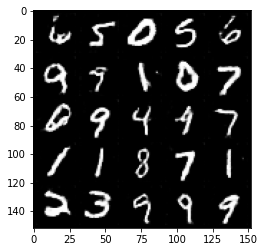

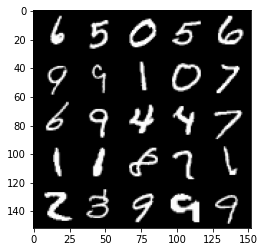

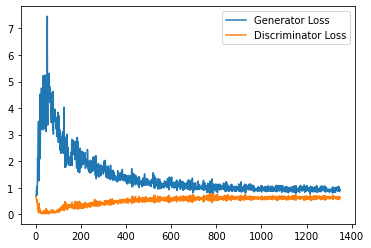

Step 27500: Generator loss: 0.9174956327676773, discriminator loss: 0.6283003315925598


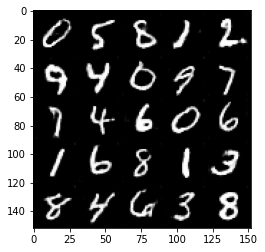

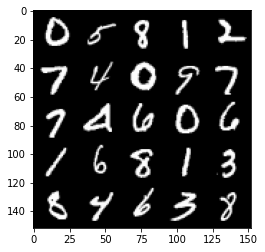

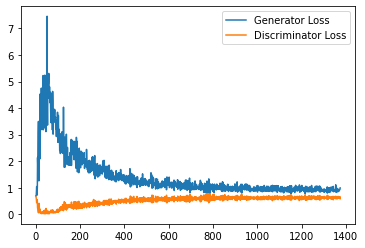

Step 28000: Generator loss: 0.8904323724508285, discriminator loss: 0.6277661246061325


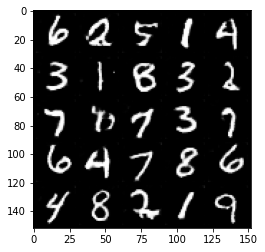

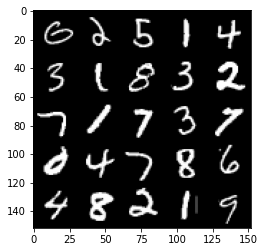

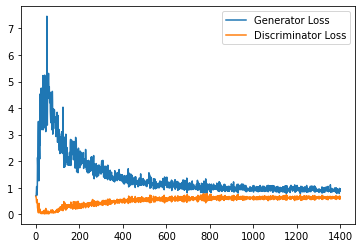

Step 28500: Generator loss: 0.904762992978096, discriminator loss: 0.6273726825714111


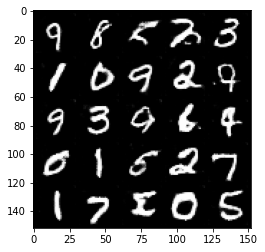

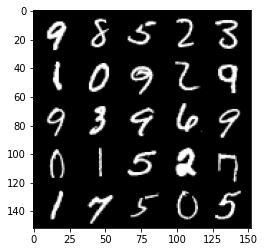

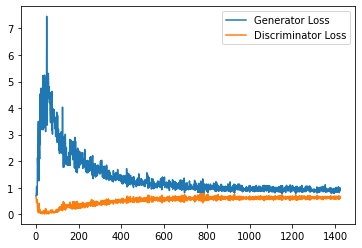

Step 29000: Generator loss: 0.901922046661377, discriminator loss: 0.6247523586153985


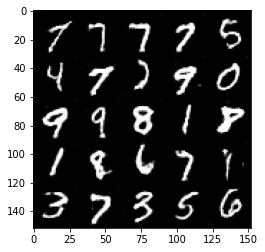

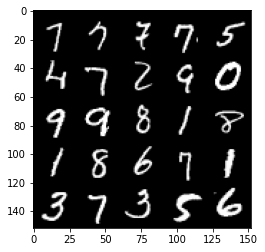

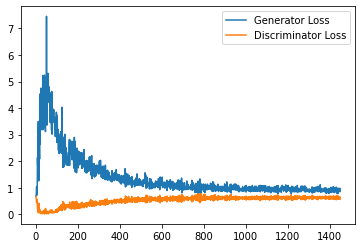

Step 29500: Generator loss: 0.9091277624368668, discriminator loss: 0.6272269377708435


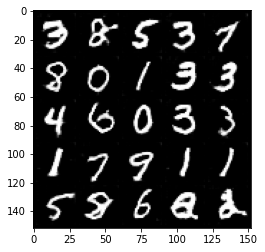

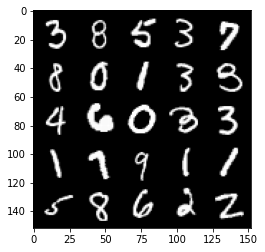

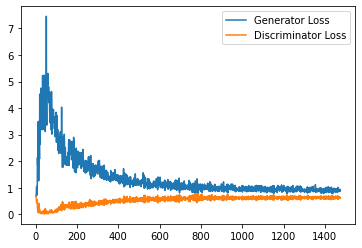

Step 30000: Generator loss: 0.9158243482112884, discriminator loss: 0.6292603986263275


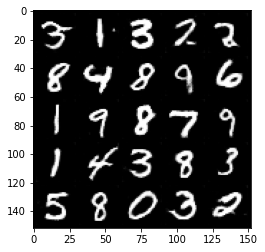

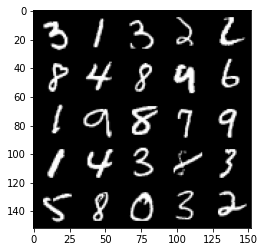

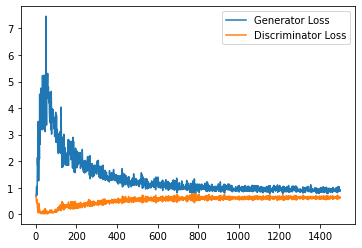

Step 30500: Generator loss: 0.9029172842502594, discriminator loss: 0.6301785477399826


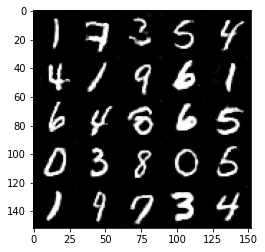

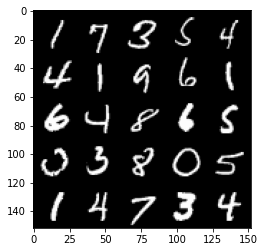

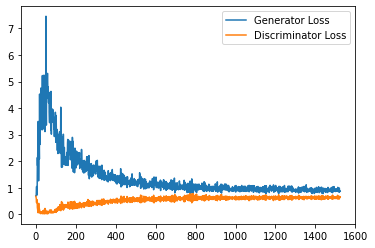

Step 31000: Generator loss: 0.9146808314323426, discriminator loss: 0.6360402562022209


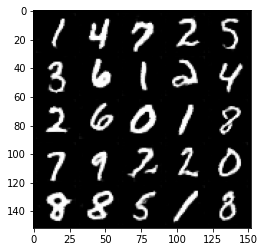

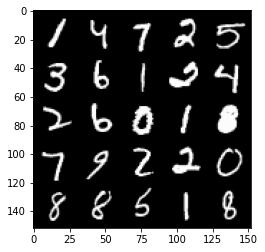

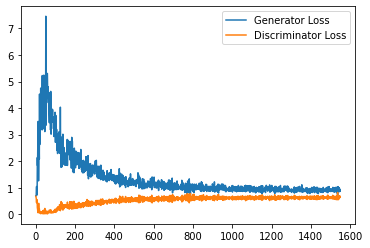

Step 31500: Generator loss: 0.8993749272823334, discriminator loss: 0.6305788383483887


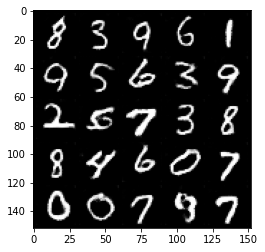

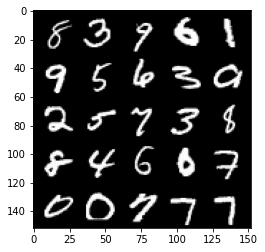

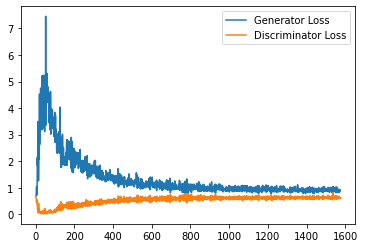

Step 32000: Generator loss: 0.9046933453083038, discriminator loss: 0.6318806681632996


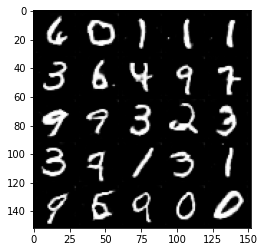

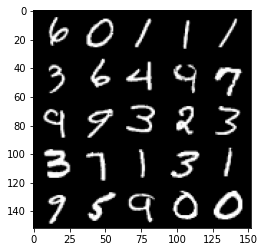

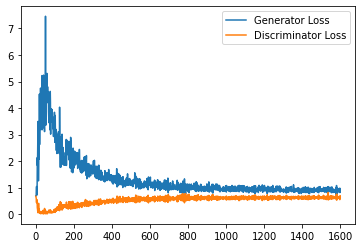

Step 32500: Generator loss: 0.8802538452148437, discriminator loss: 0.6298364396095276


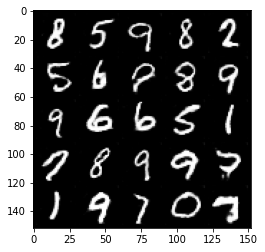

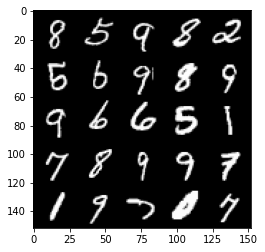

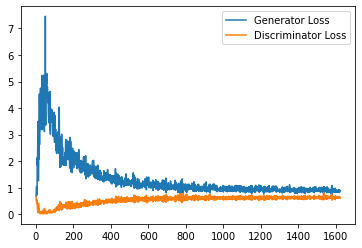

Step 33000: Generator loss: 0.8852278629541397, discriminator loss: 0.6290067176818848


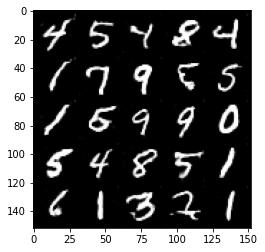

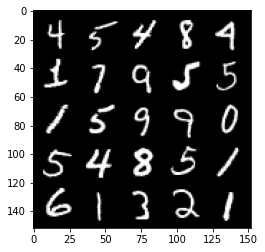

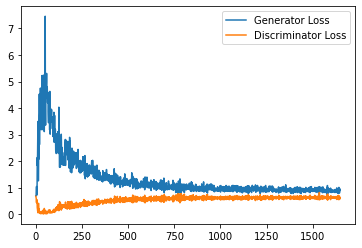

Step 33500: Generator loss: 0.8967997933626175, discriminator loss: 0.6324865848422051


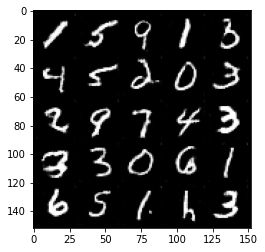

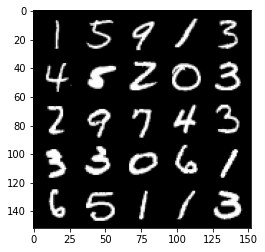

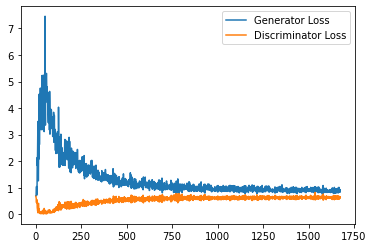

Step 34000: Generator loss: 0.9274246450662613, discriminator loss: 0.6262821196317673


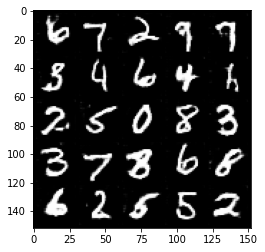

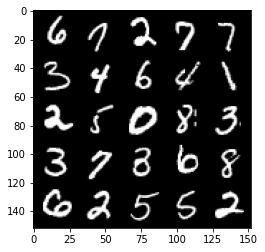

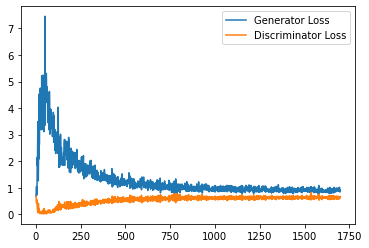

Step 34500: Generator loss: 0.8904382002353668, discriminator loss: 0.6296988289356231


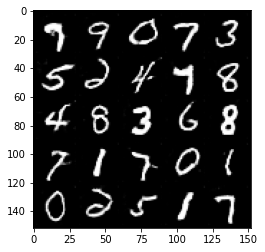

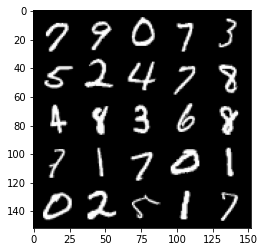

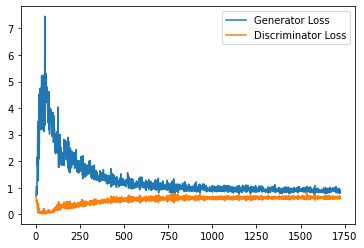

Step 35000: Generator loss: 0.8895112098455429, discriminator loss: 0.6288302427530289


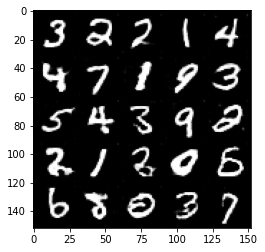

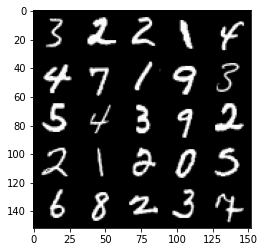

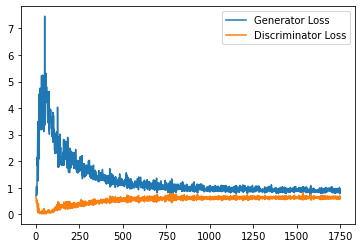

Step 35500: Generator loss: 0.897340864777565, discriminator loss: 0.6316107686758041


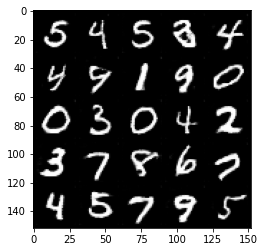

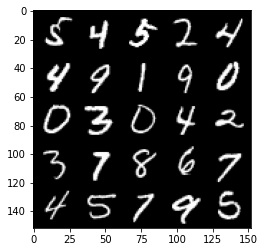

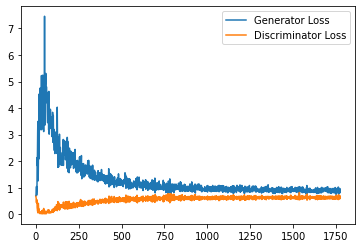

Step 36000: Generator loss: 0.9041253516674042, discriminator loss: 0.6295586158037185


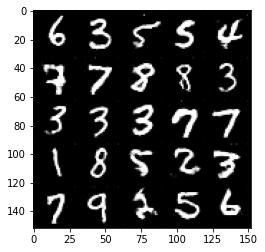

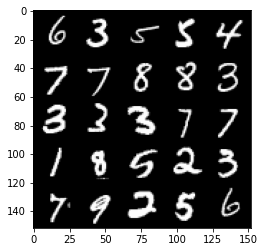

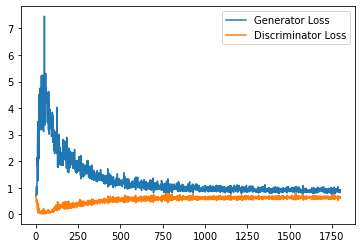

Step 36500: Generator loss: 0.8948425769805908, discriminator loss: 0.6290370401144028


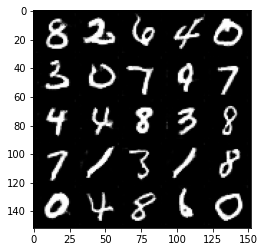

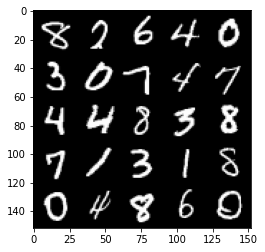

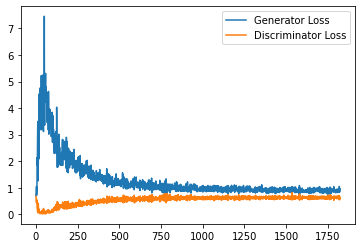

Step 37000: Generator loss: 0.9213828788995743, discriminator loss: 0.630284690618515


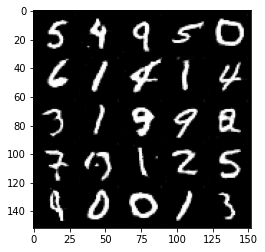

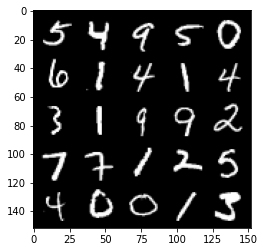

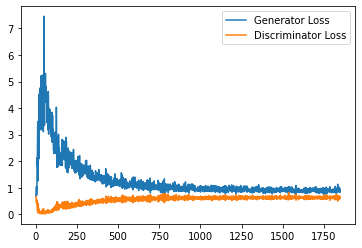

Step 37500: Generator loss: 0.8924113396406174, discriminator loss: 0.6291558436155319


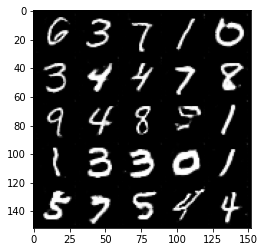

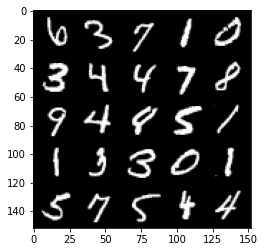

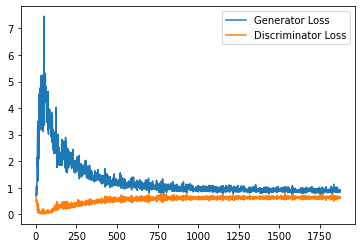

Step 38000: Generator loss: 0.8722855589389801, discriminator loss: 0.6294273561239243


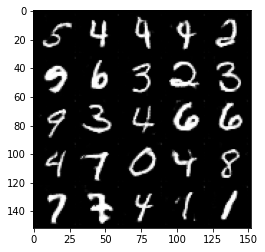

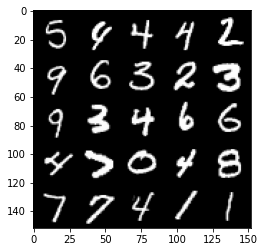

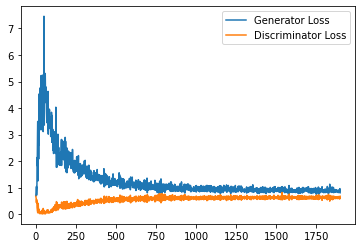

Step 38500: Generator loss: 0.8774795136451721, discriminator loss: 0.6285413780212402


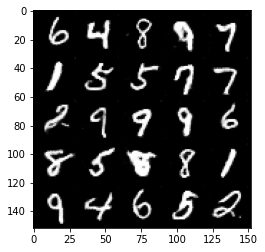

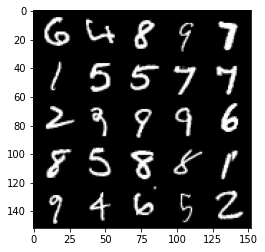

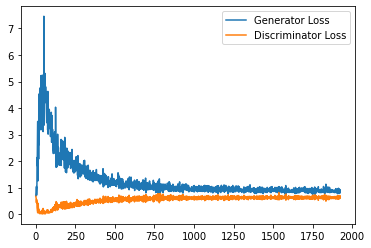

Step 39000: Generator loss: 0.8855615613460541, discriminator loss: 0.6287791734337806


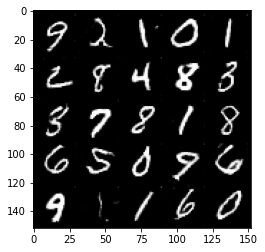

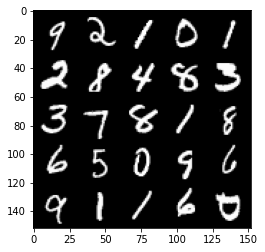

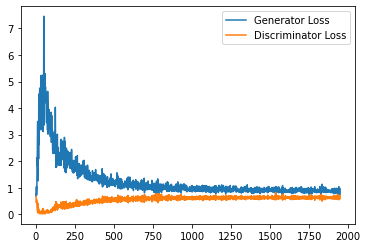

Step 39500: Generator loss: 0.8959156275987625, discriminator loss: 0.6274738943576813


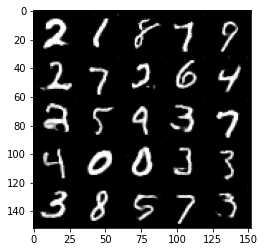

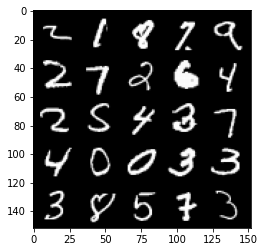

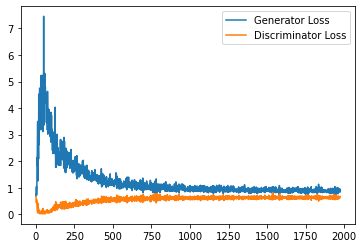

Step 40000: Generator loss: 0.9028260407447815, discriminator loss: 0.6259529207944869


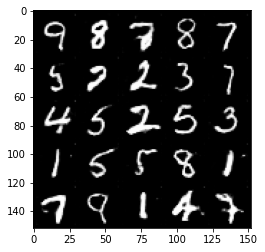

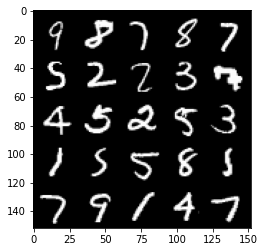

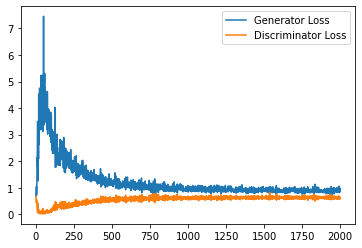

Step 40500: Generator loss: 0.9077095304727554, discriminator loss: 0.6286988977193833


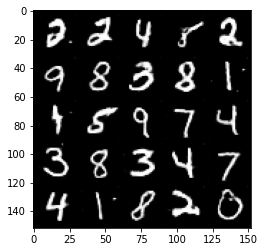

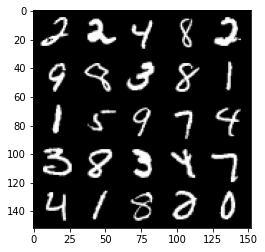

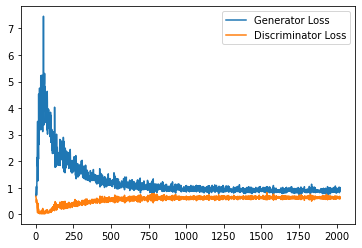

Step 41000: Generator loss: 0.9071042940616608, discriminator loss: 0.6294358080029487


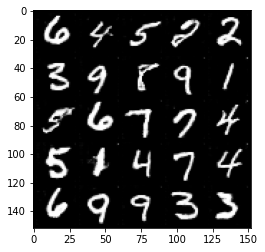

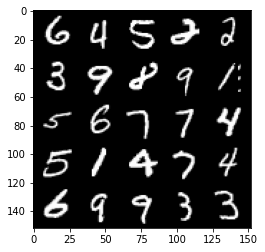

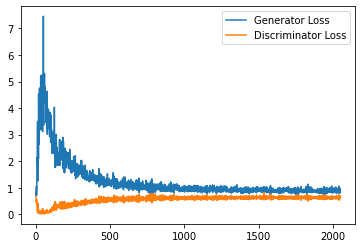

Step 41500: Generator loss: 0.8851993952989579, discriminator loss: 0.6282054365873336


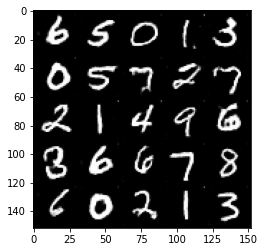

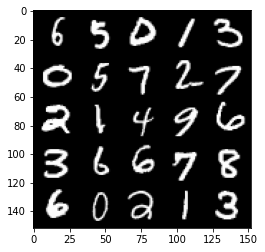

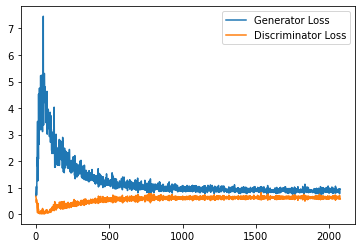

Step 42000: Generator loss: 0.8993722678422927, discriminator loss: 0.6312599271535874


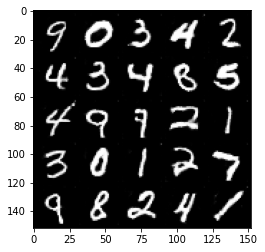

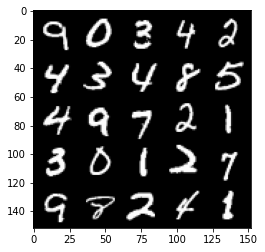

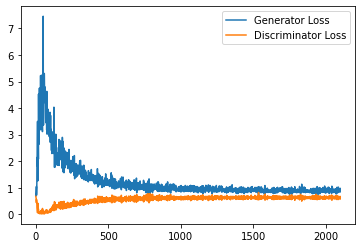

Step 42500: Generator loss: 0.9234581439495086, discriminator loss: 0.6269961667060852


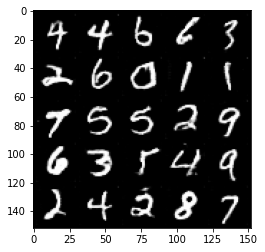

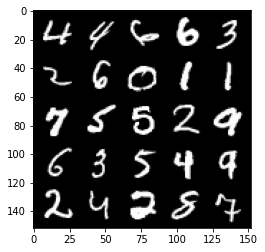

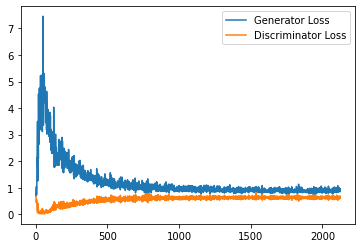

Step 43000: Generator loss: 0.9160906796455384, discriminator loss: 0.6244888649582863


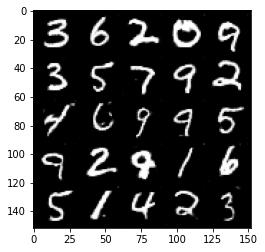

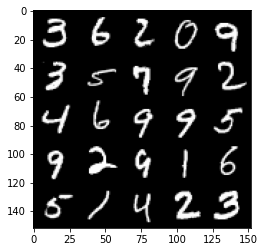

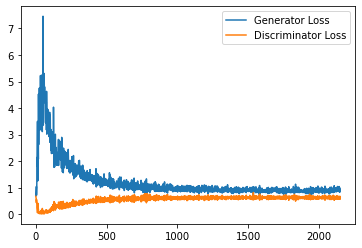

Step 43500: Generator loss: 0.895271683216095, discriminator loss: 0.6283377293348312


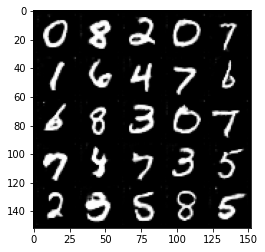

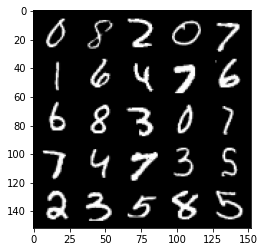

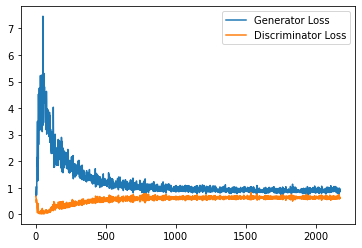

Step 44000: Generator loss: 0.8920101610422134, discriminator loss: 0.6299989703893661


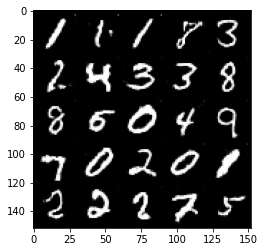

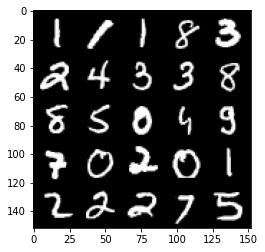

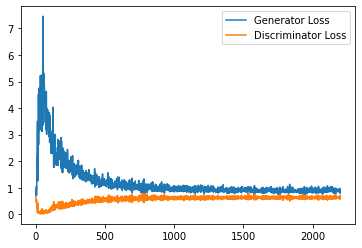

Step 44500: Generator loss: 0.8905954545736313, discriminator loss: 0.6283772674798965


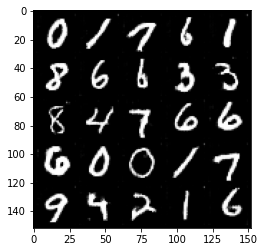

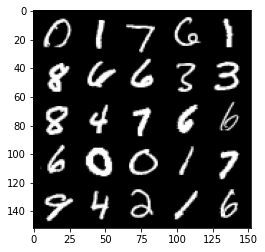

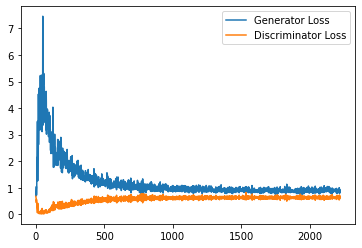

Step 45000: Generator loss: 0.9174682034254074, discriminator loss: 0.6245072109699249


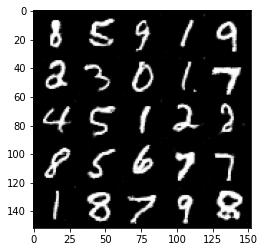

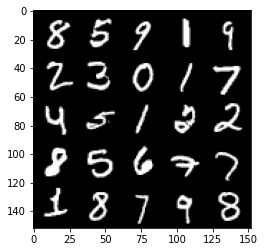

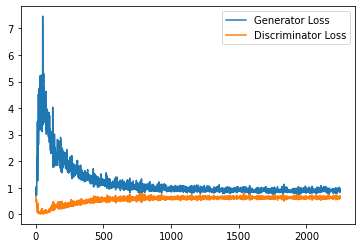

Step 45500: Generator loss: 0.9076137452125549, discriminator loss: 0.6309800955057144


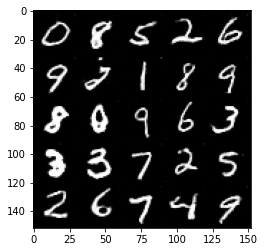

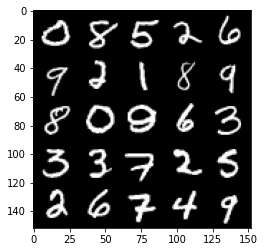

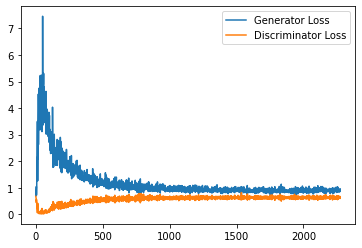

Step 46000: Generator loss: 0.9093400760889053, discriminator loss: 0.6226637268066406


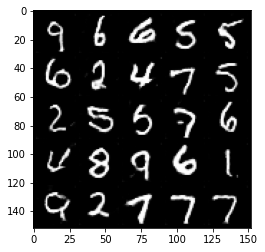

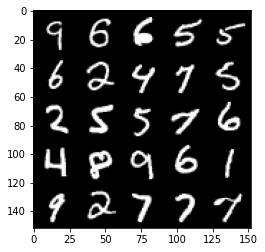

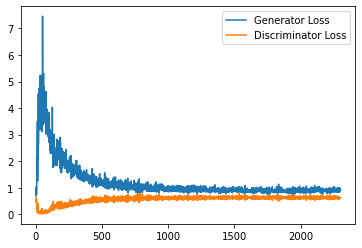

Step 46500: Generator loss: 0.8961101084947586, discriminator loss: 0.6215820429325104


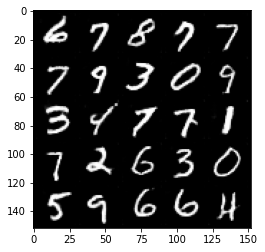

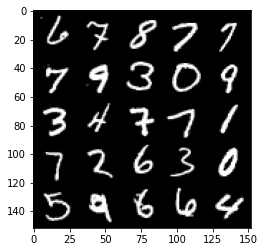

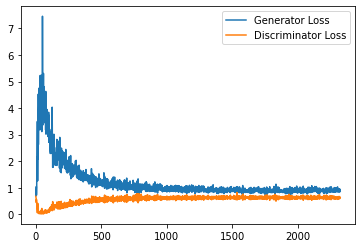

Step 47000: Generator loss: 0.8834618110656738, discriminator loss: 0.6230059052705765


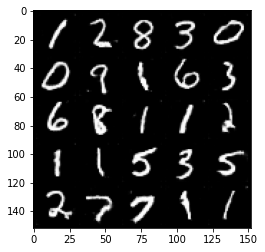

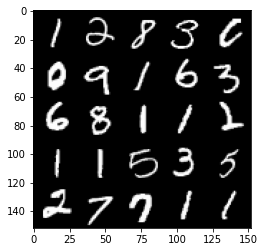

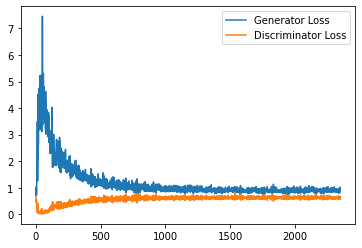

Step 47500: Generator loss: 0.9182897424697876, discriminator loss: 0.6236193434000016


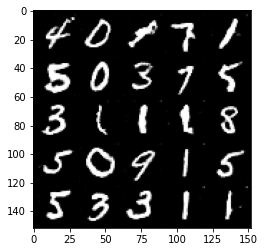

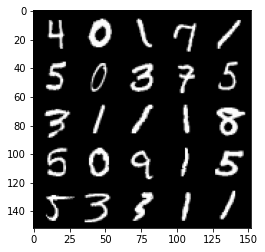

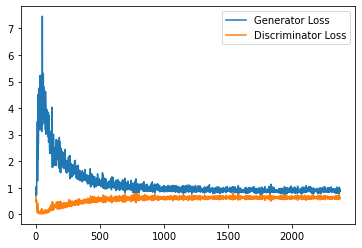

Step 48000: Generator loss: 0.9186940141916276, discriminator loss: 0.6261785541772842


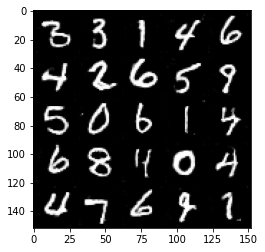

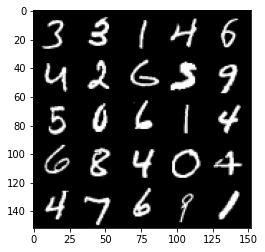

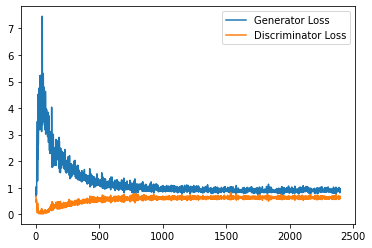

Step 48500: Generator loss: 0.9118386151790618, discriminator loss: 0.6241660975217819


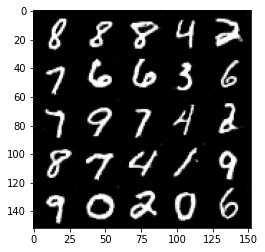

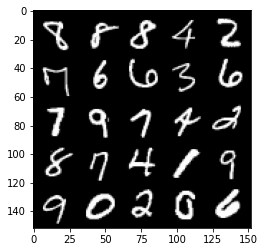

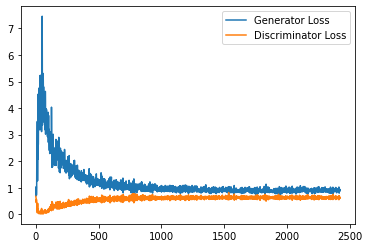

Step 49000: Generator loss: 0.9061199122667313, discriminator loss: 0.623443675160408


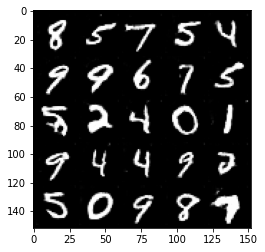

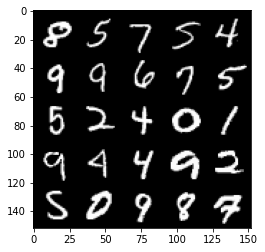

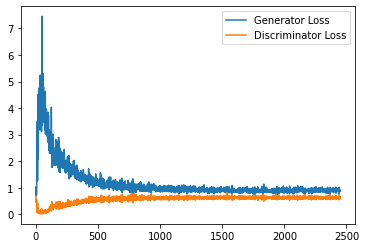

Step 49500: Generator loss: 0.9110866283178329, discriminator loss: 0.6199690074324608


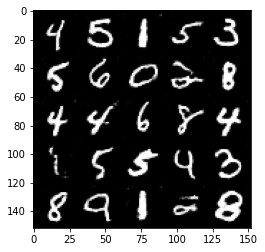

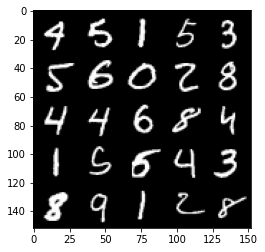

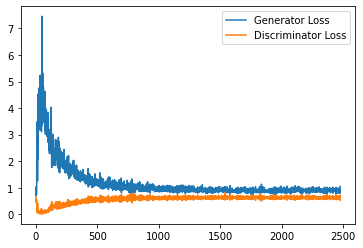

Step 50000: Generator loss: 0.9134090820550919, discriminator loss: 0.6217511357069015


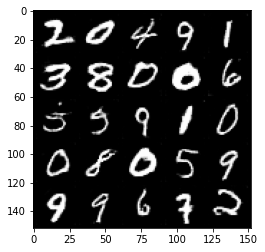

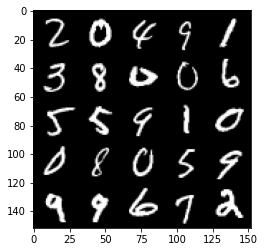

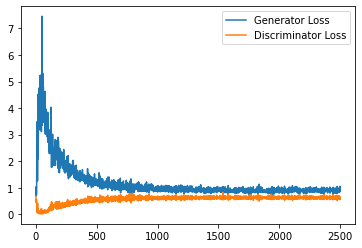

Step 50500: Generator loss: 0.9088781028985977, discriminator loss: 0.6244488252997399


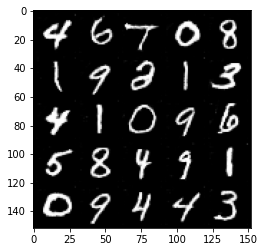

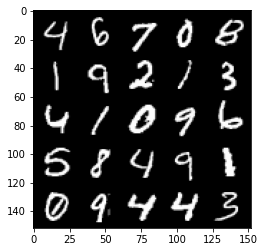

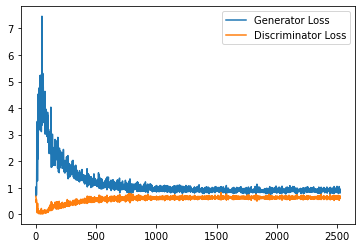

Step 51000: Generator loss: 0.8972398672103882, discriminator loss: 0.6214897308945656


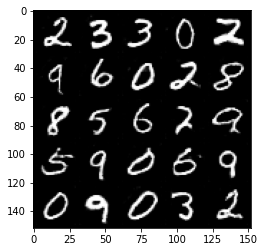

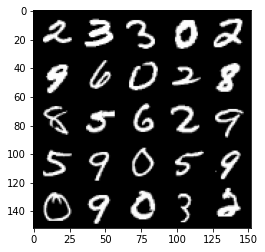

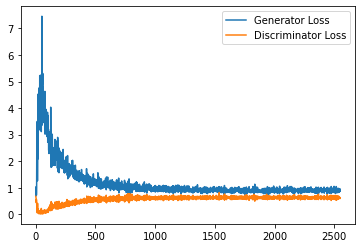

Step 51500: Generator loss: 0.9051252386569977, discriminator loss: 0.6205224485993386


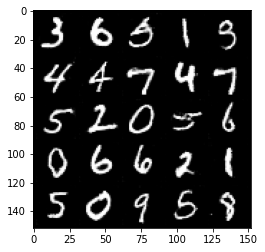

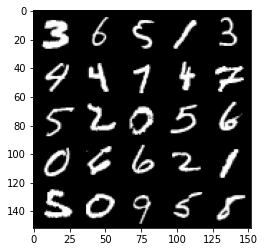

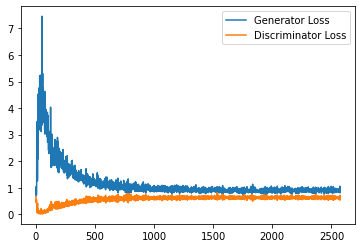

Step 52000: Generator loss: 0.9384337266683579, discriminator loss: 0.6143256304264069


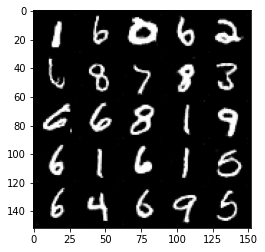

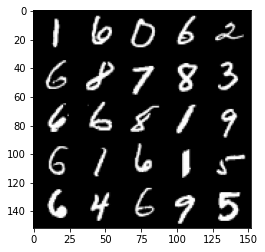

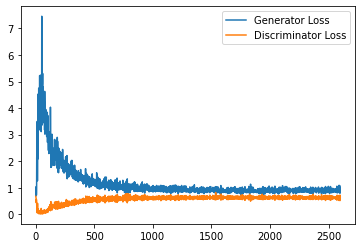

Step 52500: Generator loss: 0.9034747027158737, discriminator loss: 0.622573212146759


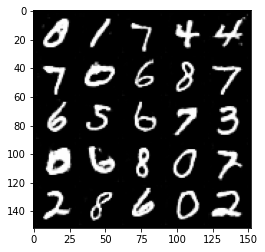

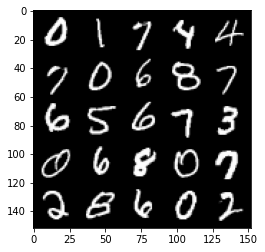

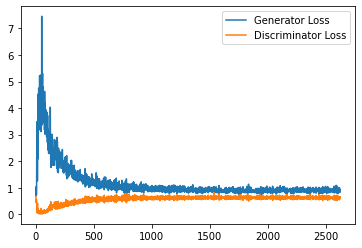

Step 53000: Generator loss: 0.9093936425447464, discriminator loss: 0.6193149882555008


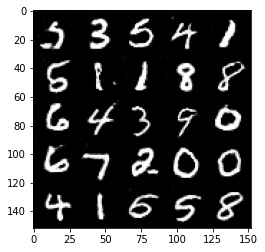

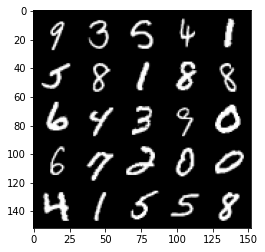

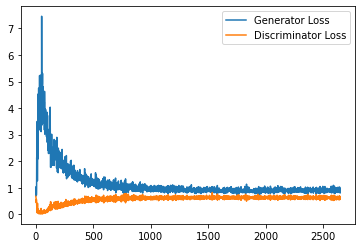

Step 53500: Generator loss: 0.9049829756021499, discriminator loss: 0.6180569025278091


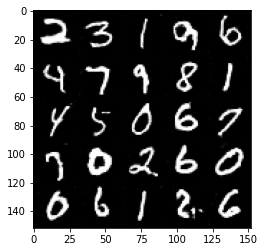

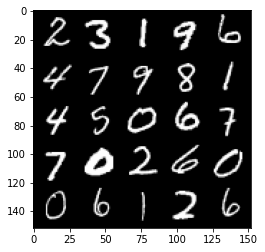

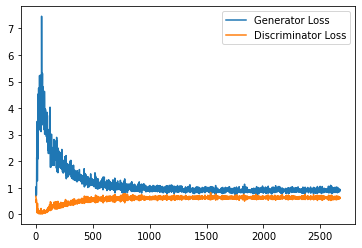

Step 54000: Generator loss: 0.9293031843900681, discriminator loss: 0.6185041832327842


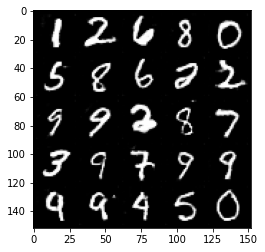

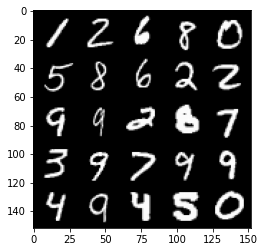

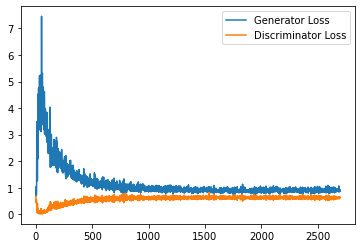

Step 54500: Generator loss: 0.9167586557865143, discriminator loss: 0.6192549215555191


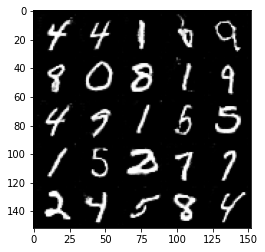

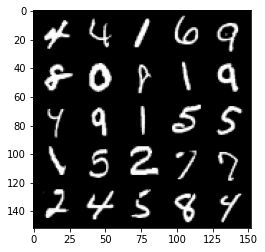

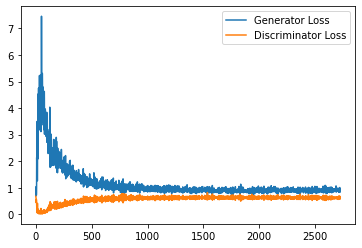

Step 55000: Generator loss: 0.9010500086545944, discriminator loss: 0.6240805947184562


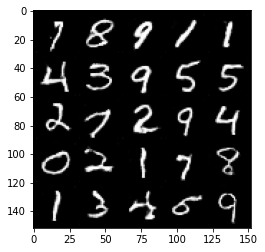

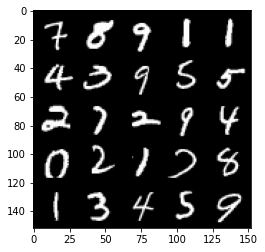

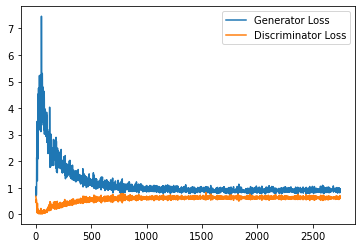

Step 55500: Generator loss: 0.9139797449111938, discriminator loss: 0.6240941170454025


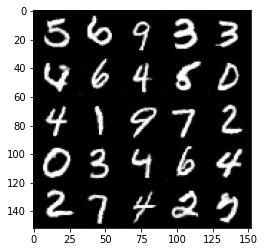

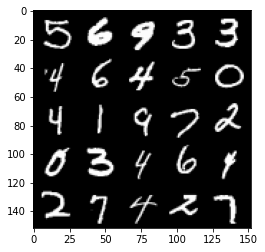

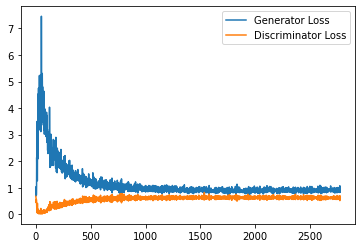

Step 56000: Generator loss: 0.9120246180295944, discriminator loss: 0.6175302453637123


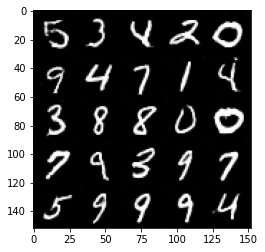

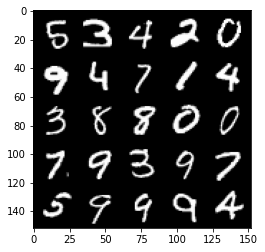

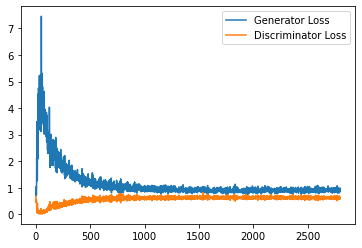

Step 56500: Generator loss: 0.9007188876867295, discriminator loss: 0.6180262393951416


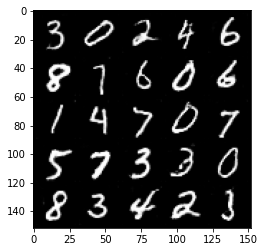

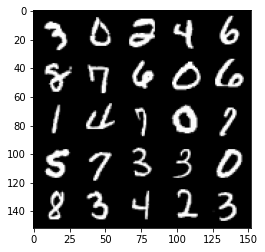

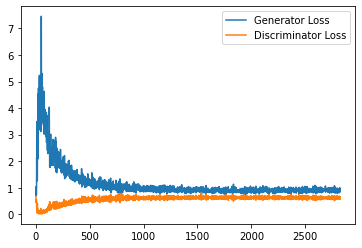

Step 57000: Generator loss: 0.9182303745746613, discriminator loss: 0.617793948173523


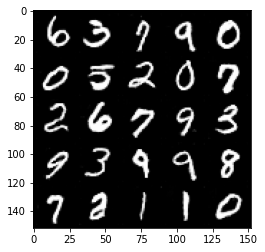

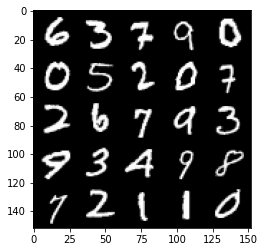

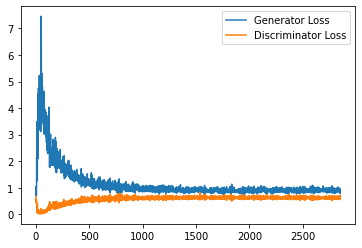

Step 57500: Generator loss: 0.9163476986885071, discriminator loss: 0.617112875342369


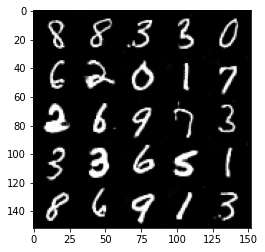

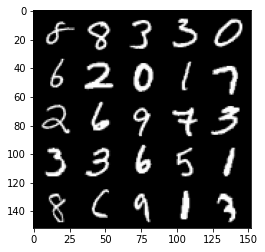

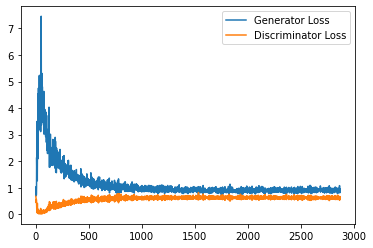

Step 58000: Generator loss: 0.9057985880374908, discriminator loss: 0.6212336062192917


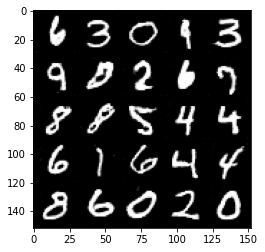

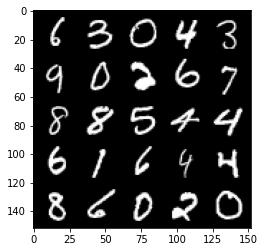

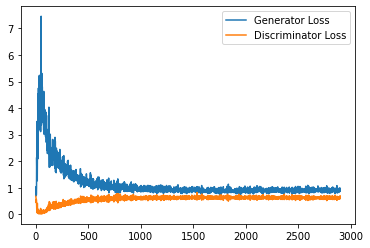

Step 58500: Generator loss: 0.9520485758781433, discriminator loss: 0.6150997114777565


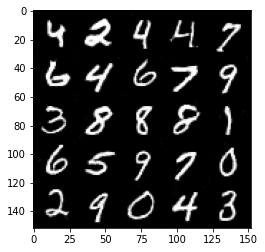

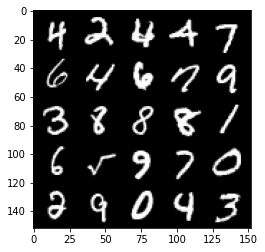

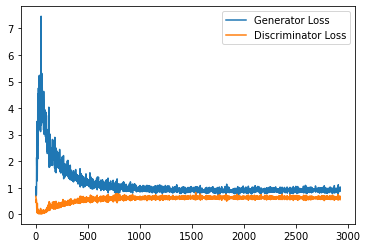

Step 59000: Generator loss: 0.9257944324016572, discriminator loss: 0.6211324628591538


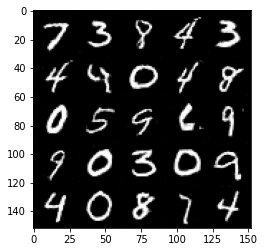

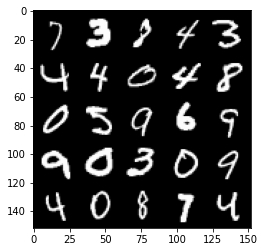

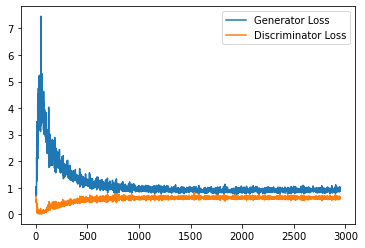

Step 59500: Generator loss: 0.9360929152965546, discriminator loss: 0.6177363882660866


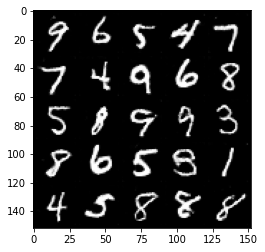

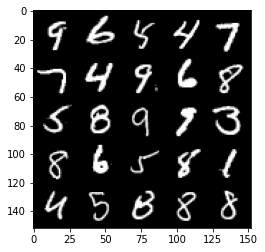

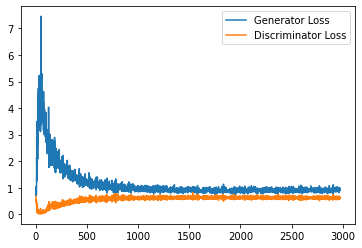

Step 60000: Generator loss: 0.9167456700801849, discriminator loss: 0.6156808550357818


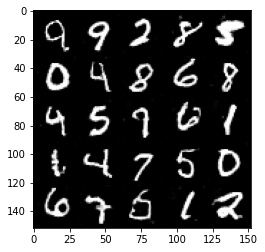

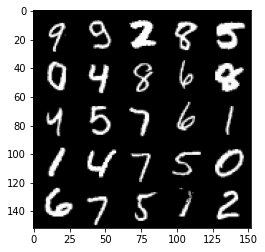

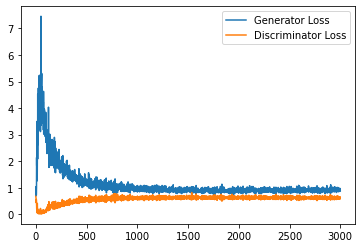

Step 60500: Generator loss: 0.9271883579492569, discriminator loss: 0.6131792402267456


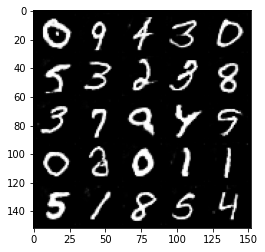

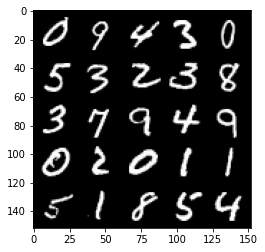

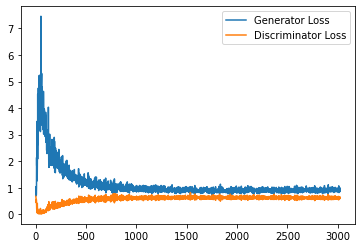

Step 61000: Generator loss: 0.9074847549200058, discriminator loss: 0.6148553029298782


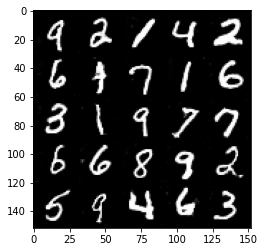

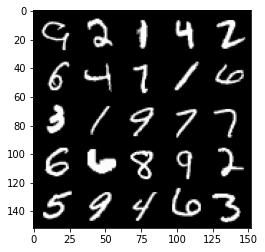

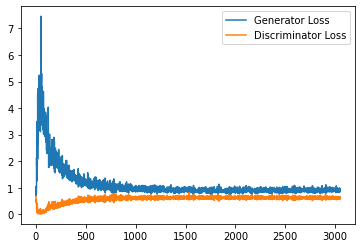

Step 61500: Generator loss: 0.9157517184019088, discriminator loss: 0.6142951179742813


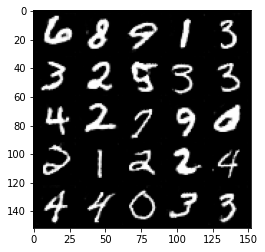

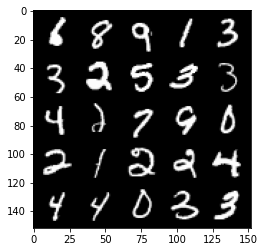

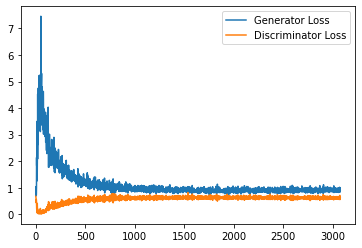

Step 62000: Generator loss: 0.9258156505823135, discriminator loss: 0.6128532068133354


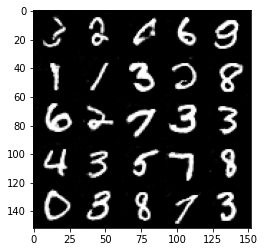

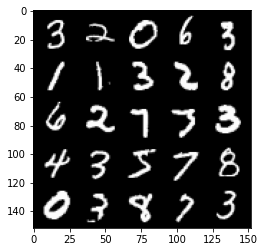

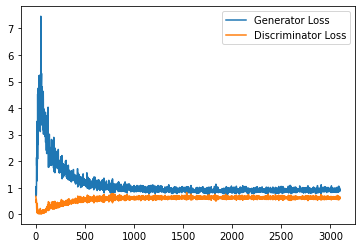

Step 62500: Generator loss: 0.9339164836406708, discriminator loss: 0.6136853348016739


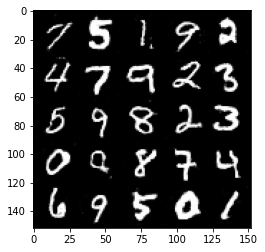

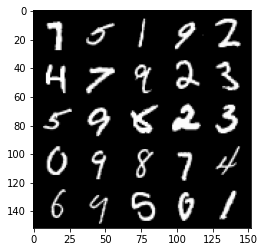

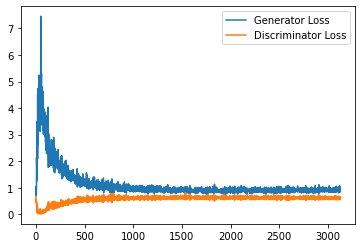

Step 63000: Generator loss: 0.9224345102310181, discriminator loss: 0.6163007785081863


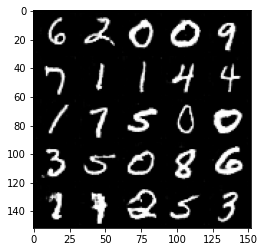

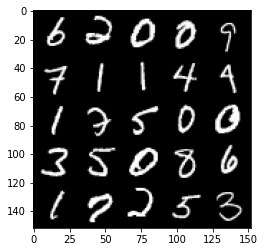

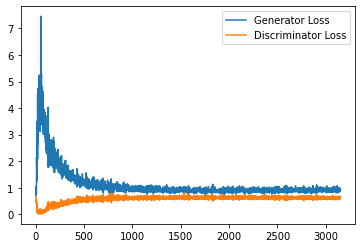

Step 63500: Generator loss: 0.9384875192642211, discriminator loss: 0.6095075103044509


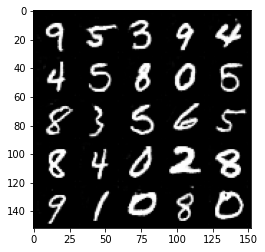

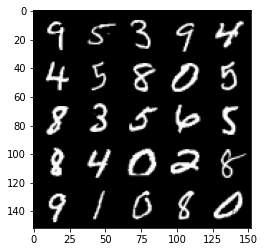

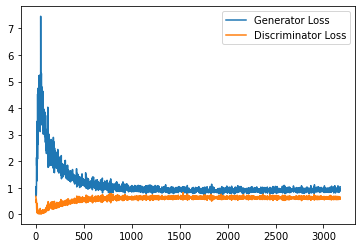

Step 64000: Generator loss: 0.935436647772789, discriminator loss: 0.6134960930347443


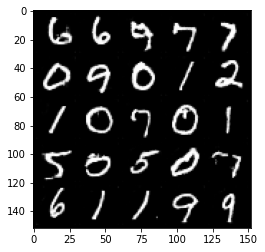

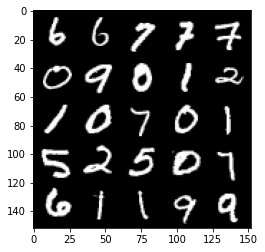

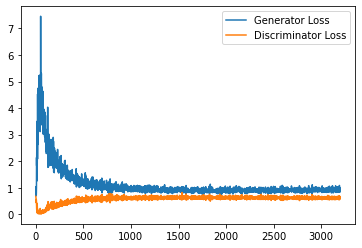

Step 64500: Generator loss: 0.9288940930366516, discriminator loss: 0.6083445306420326


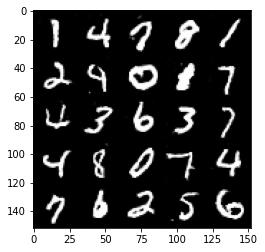

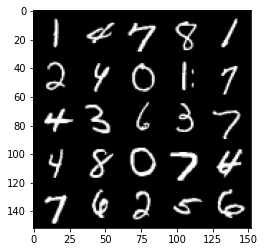

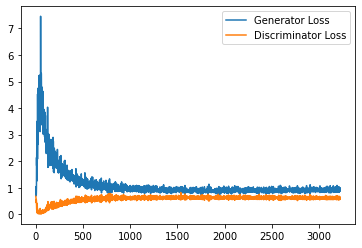

Step 65000: Generator loss: 0.9663584507703781, discriminator loss: 0.6093613211512565


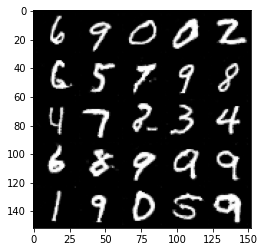

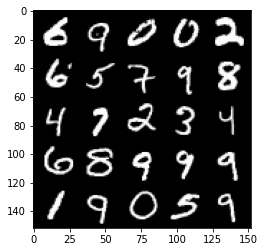

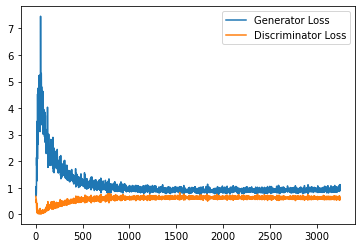

Step 65500: Generator loss: 0.9447161339521408, discriminator loss: 0.6100467631220817


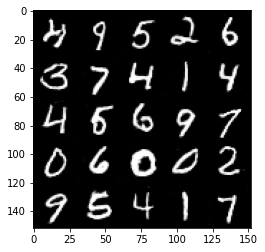

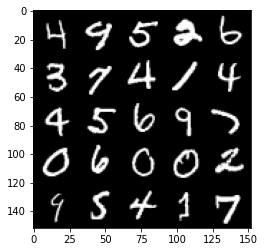

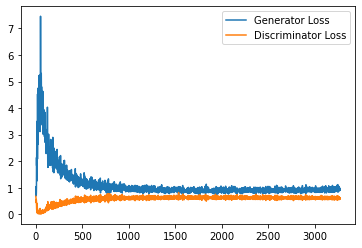

Step 66000: Generator loss: 0.9424728499650955, discriminator loss: 0.610023333966732


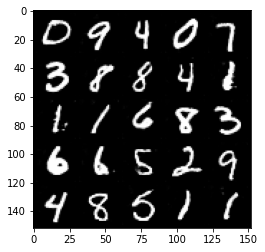

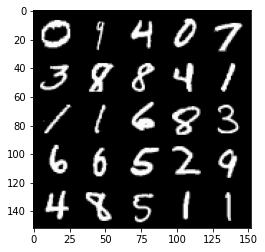

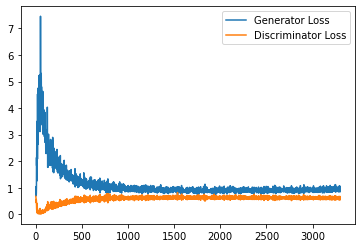

Step 66500: Generator loss: 0.9372968634366989, discriminator loss: 0.606555165886879


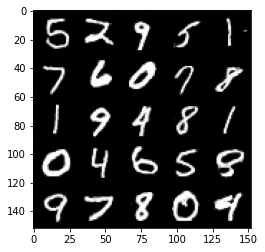

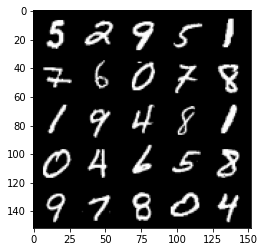

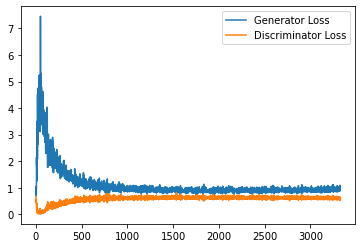

Step 67000: Generator loss: 0.947789253115654, discriminator loss: 0.6118152242302894


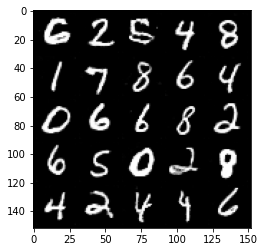

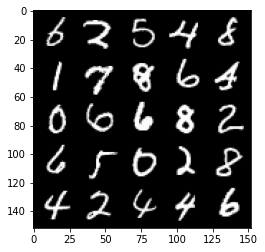

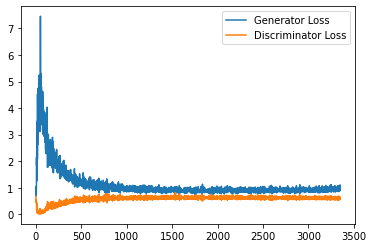

Step 67500: Generator loss: 0.952292554140091, discriminator loss: 0.611369433581829


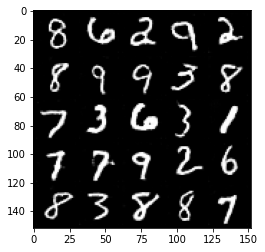

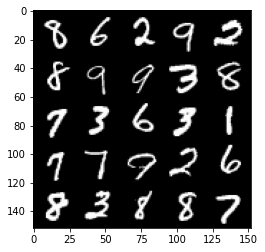

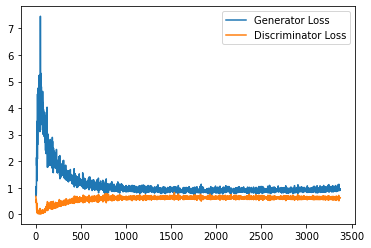

Step 68000: Generator loss: 0.9455143407583236, discriminator loss: 0.6043013700246811


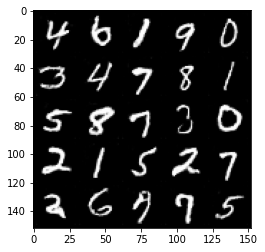

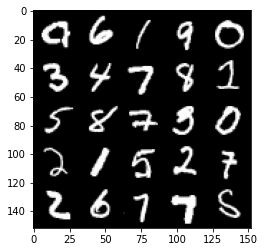

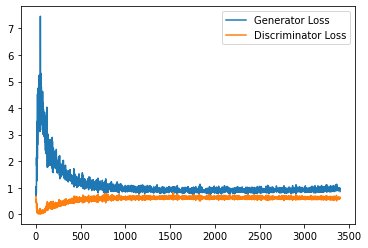

Step 68500: Generator loss: 0.9396381005048752, discriminator loss: 0.6050085502266884


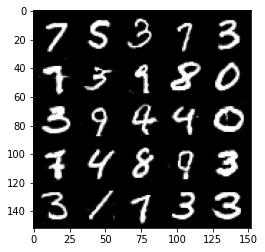

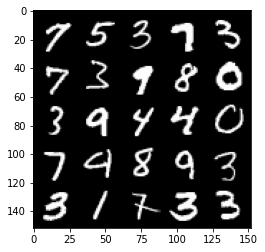

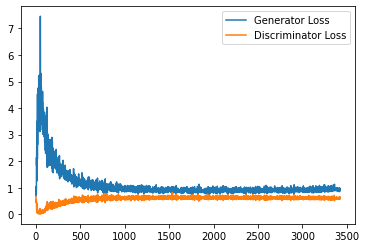

Step 69000: Generator loss: 0.9542912697792053, discriminator loss: 0.604485180914402


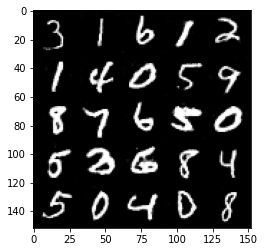

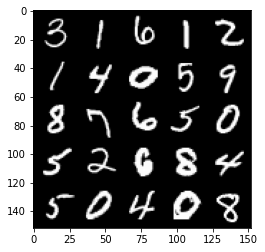

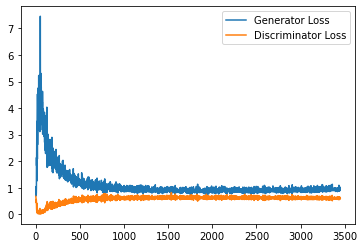

Step 69500: Generator loss: 0.9479356696605682, discriminator loss: 0.6065800666809082


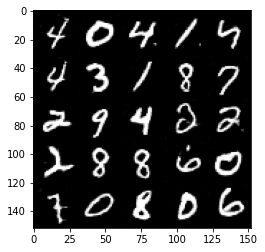

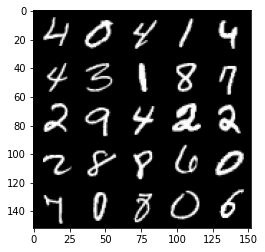

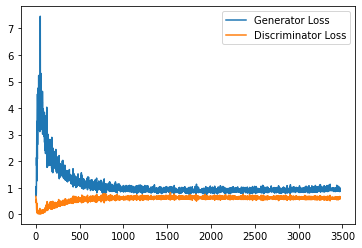

Step 70000: Generator loss: 0.937929694890976, discriminator loss: 0.6061727075576783


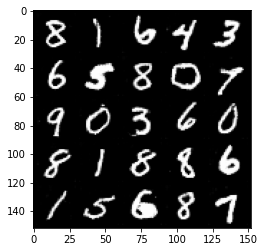

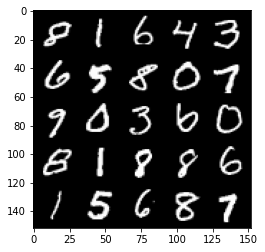

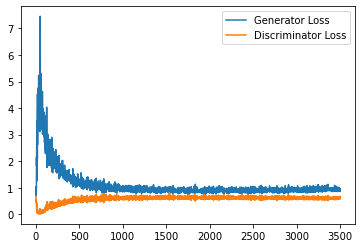

Step 70500: Generator loss: 0.9622428292036056, discriminator loss: 0.6003938355445861


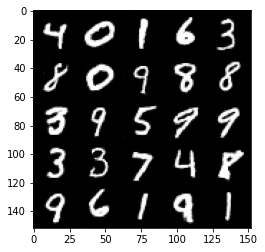

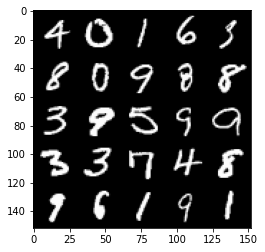

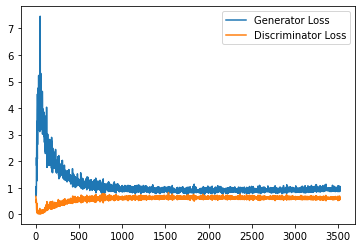

Step 71000: Generator loss: 0.9593920357227326, discriminator loss: 0.6039275171756744


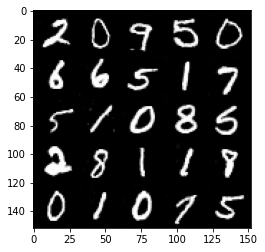

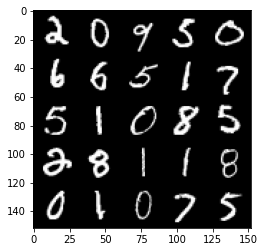

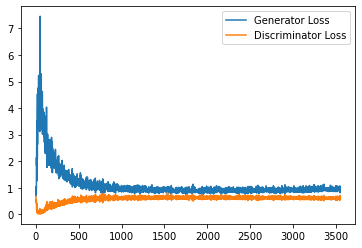

Step 71500: Generator loss: 0.950257483124733, discriminator loss: 0.6071387263536453


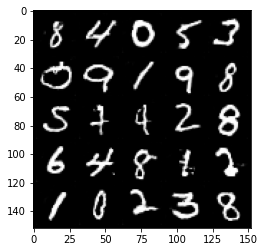

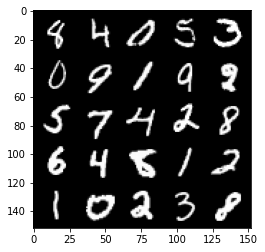

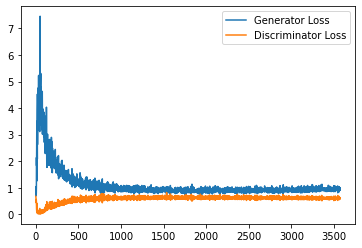

Step 72000: Generator loss: 0.9361634535789489, discriminator loss: 0.6084198920726777


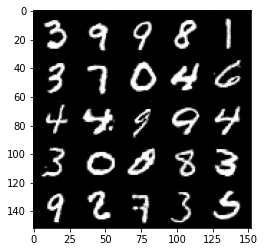

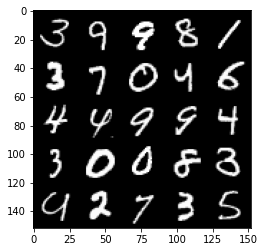

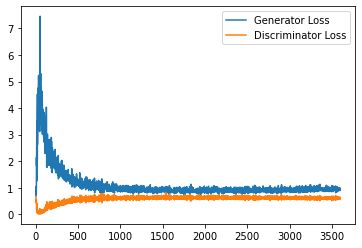

Step 72500: Generator loss: 0.9601701350212097, discriminator loss: 0.605492928147316


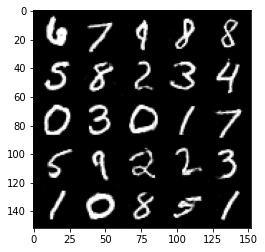

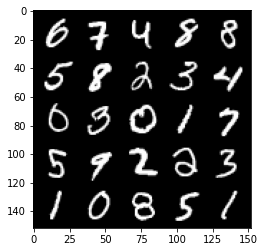

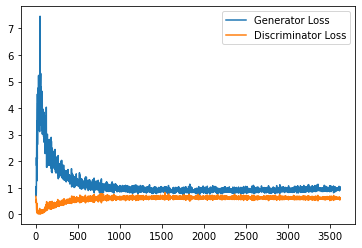

Step 73000: Generator loss: 0.9402122875452041, discriminator loss: 0.6065387795567513


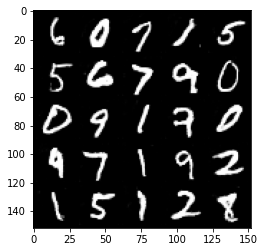

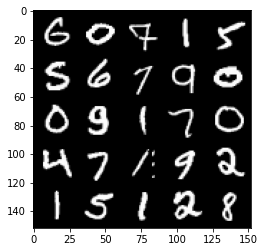

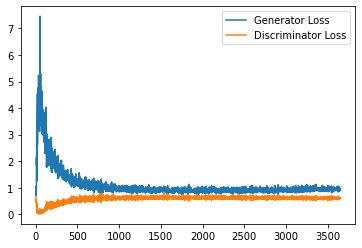

Step 73500: Generator loss: 0.9502294715642929, discriminator loss: 0.6065287906527519


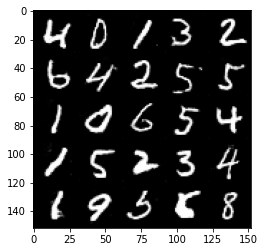

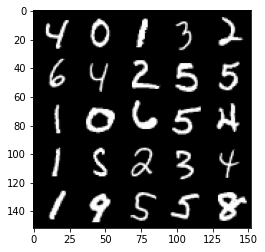

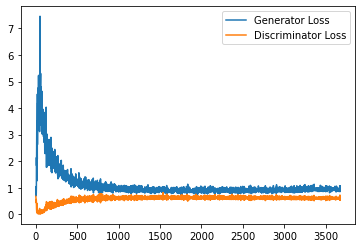

Step 74000: Generator loss: 0.9627892347574234, discriminator loss: 0.6102254431843758


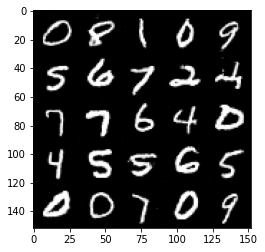

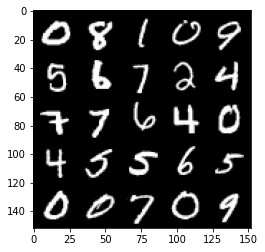

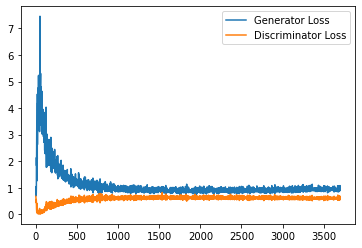

Step 74500: Generator loss: 0.9498639810085296, discriminator loss: 0.6060977001786232


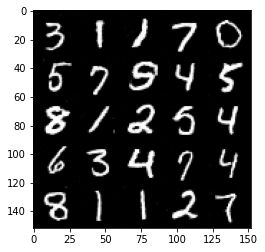

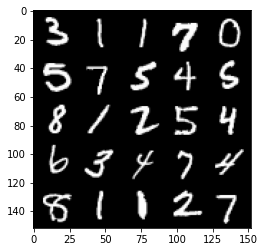

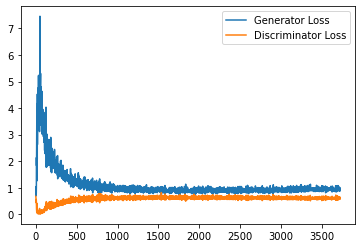

Step 75000: Generator loss: 0.9402809973955154, discriminator loss: 0.602528828561306


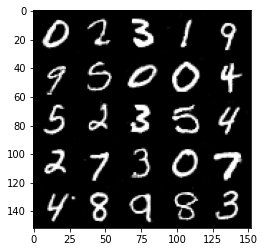

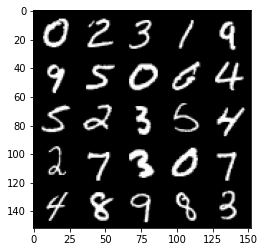

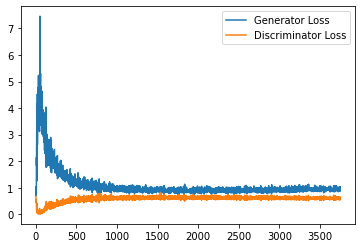

Step 75500: Generator loss: 0.9567783464193345, discriminator loss: 0.6052382338643074


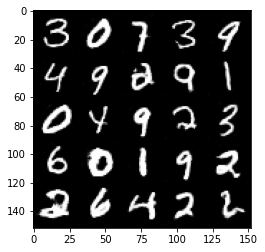

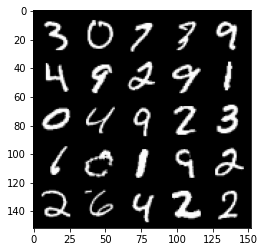

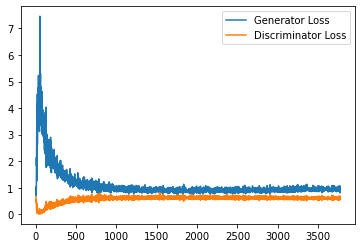

Step 76000: Generator loss: 0.9646093699932098, discriminator loss: 0.6079401302337647


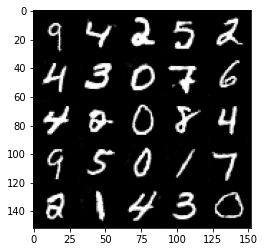

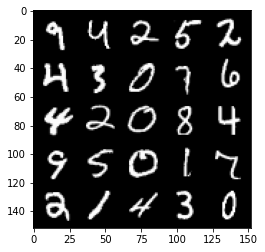

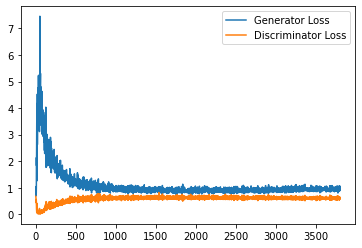

Step 76500: Generator loss: 0.9520811442136764, discriminator loss: 0.6038902597427368


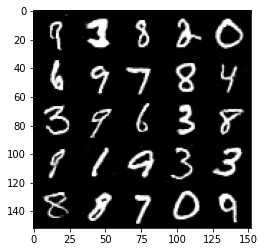

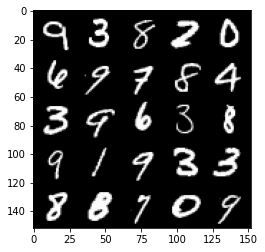

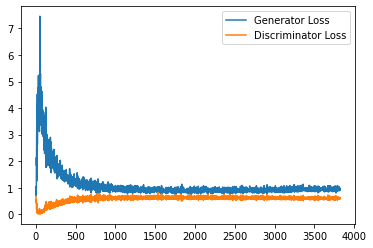

Step 77000: Generator loss: 0.945805830359459, discriminator loss: 0.6043258432149887


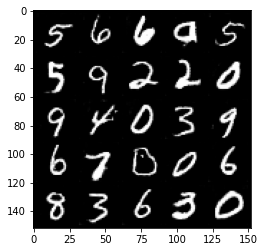

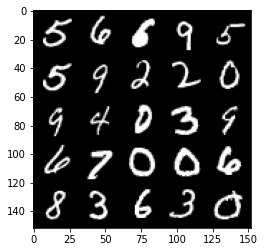

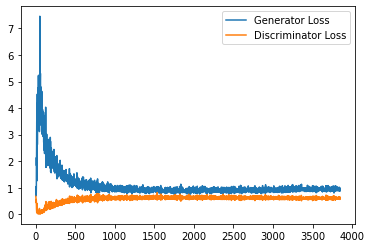

Step 77500: Generator loss: 0.9496577332019805, discriminator loss: 0.6042882113456726


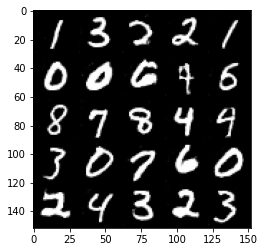

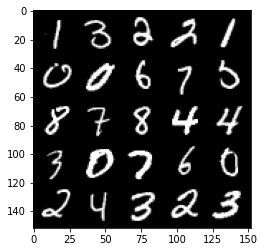

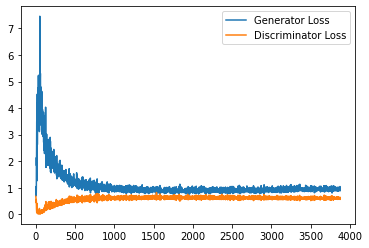

Step 78000: Generator loss: 0.9422644522190095, discriminator loss: 0.6095272244215012


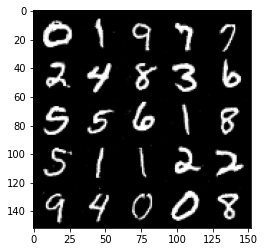

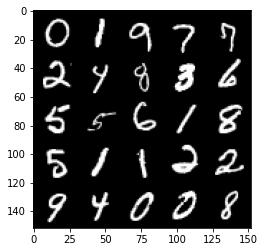

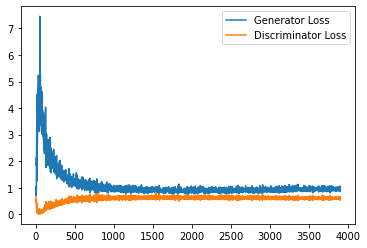

Step 78500: Generator loss: 0.9582318497896194, discriminator loss: 0.6078875530958175


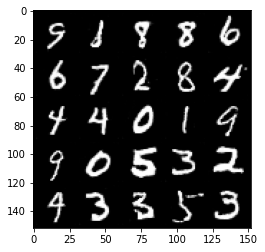

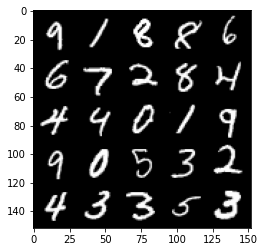

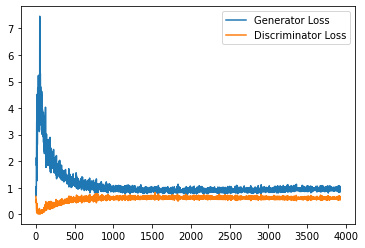

Step 79000: Generator loss: 0.9566743426322937, discriminator loss: 0.6083759212493897


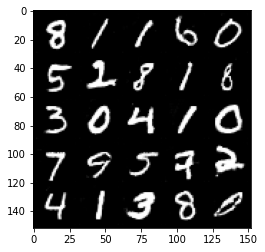

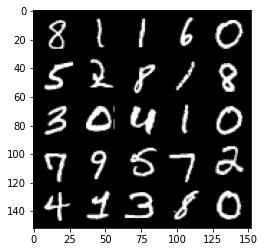

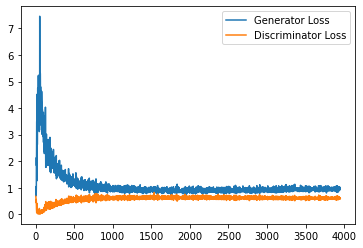

Step 79500: Generator loss: 0.9570980017185211, discriminator loss: 0.6070652769207955


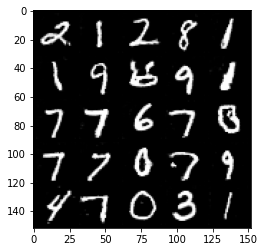

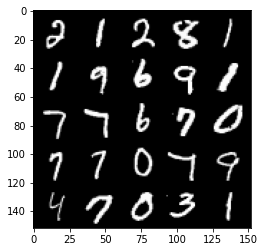

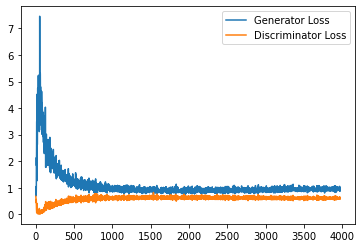

Step 80000: Generator loss: 0.9478111418485642, discriminator loss: 0.6040695044994354


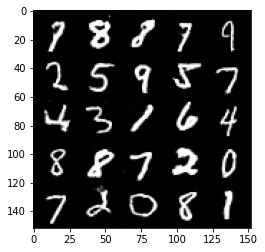

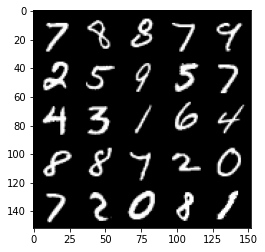

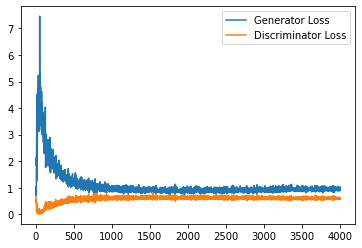

Step 80500: Generator loss: 0.9500482258796692, discriminator loss: 0.6077632594108582


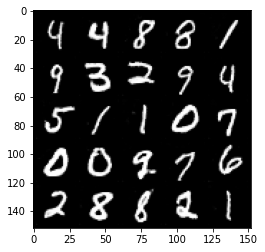

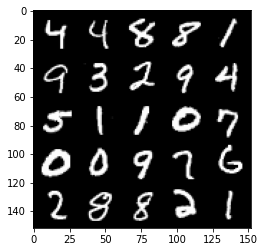

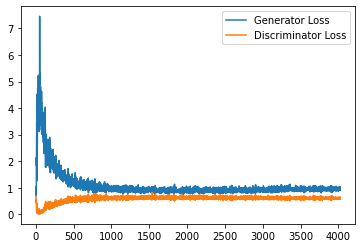

Step 81000: Generator loss: 0.9577330374717712, discriminator loss: 0.6091283888220788


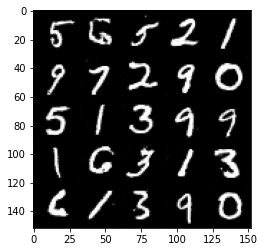

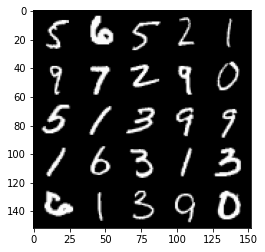

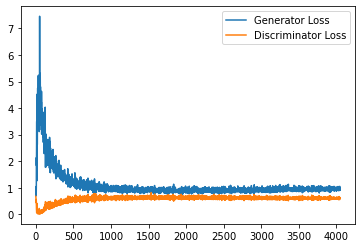

Step 81500: Generator loss: 0.9488576149940491, discriminator loss: 0.6074406472444535


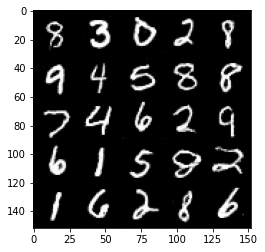

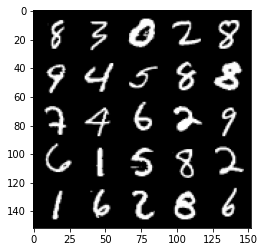

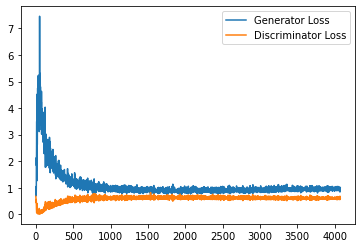

Step 82000: Generator loss: 0.9541488624811173, discriminator loss: 0.6104192849993706


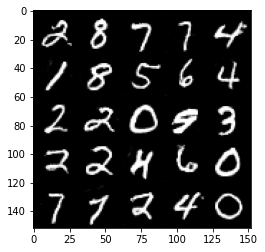

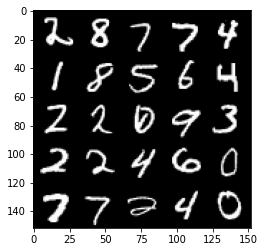

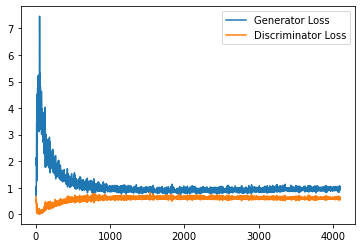

Step 82500: Generator loss: 0.942852220416069, discriminator loss: 0.6083574086427689


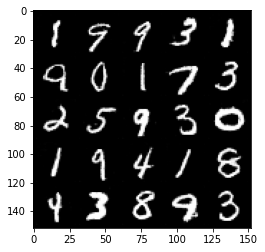

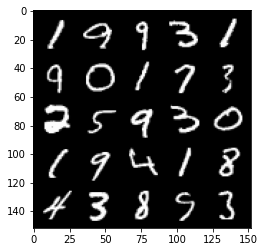

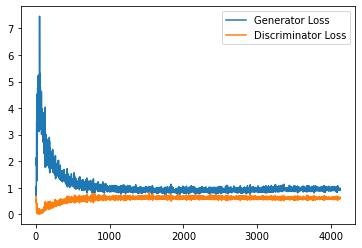

Step 83000: Generator loss: 0.9566050871610642, discriminator loss: 0.6144221721291542


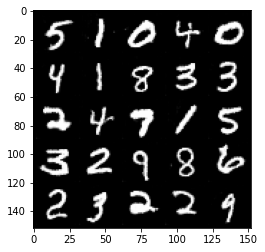

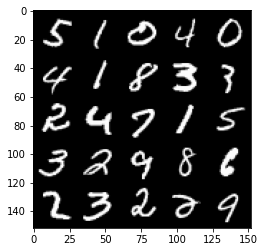

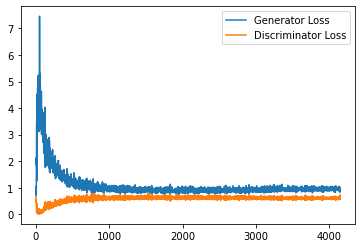

Step 83500: Generator loss: 0.9727686593532562, discriminator loss: 0.6059257597327232


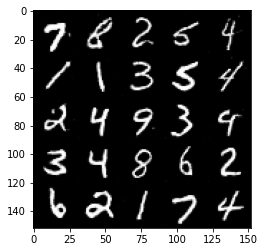

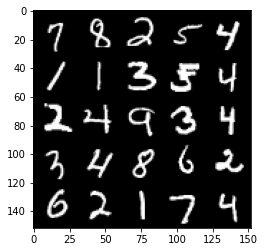

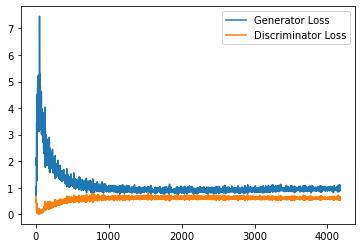

Step 84000: Generator loss: 0.9476307458877563, discriminator loss: 0.6100950726270675


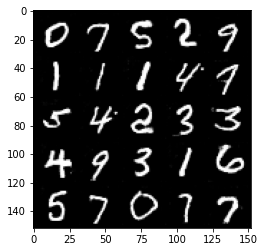

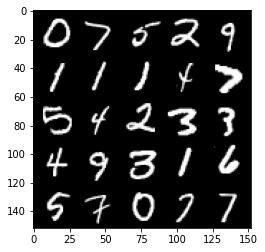

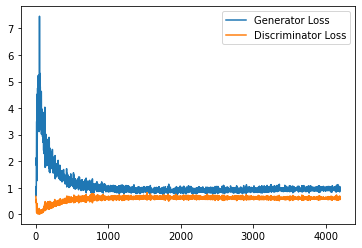

Step 84500: Generator loss: 0.9421021698713302, discriminator loss: 0.6120483027696609


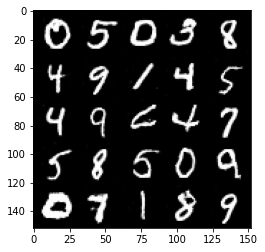

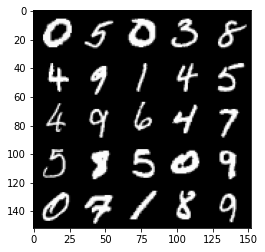

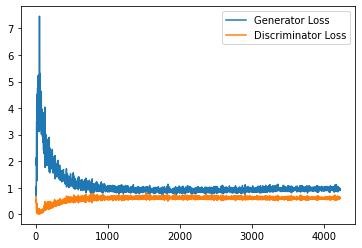

Step 85000: Generator loss: 0.9400044922828674, discriminator loss: 0.6065764837265014


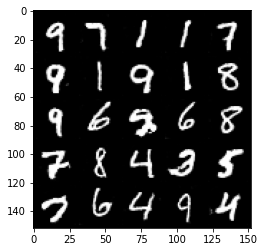

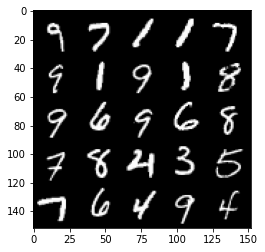

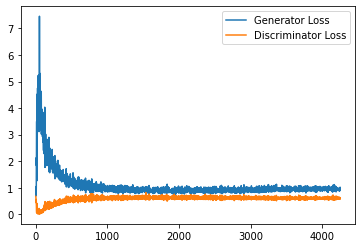

Step 85500: Generator loss: 0.9603190521001815, discriminator loss: 0.61540094602108


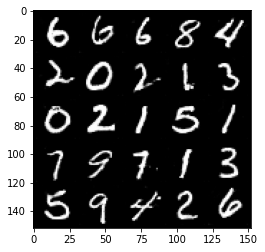

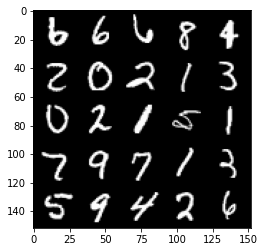

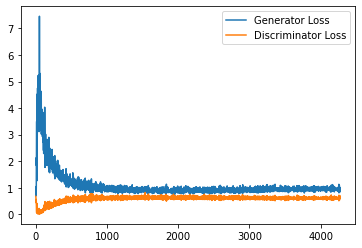

Step 86000: Generator loss: 0.9552462569475174, discriminator loss: 0.6089356623888016


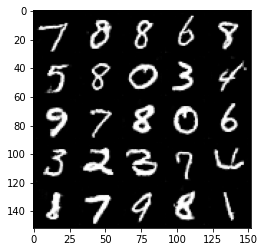

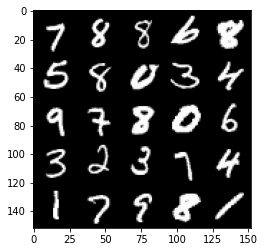

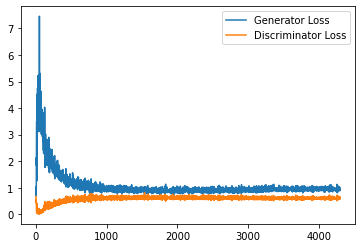

Step 86500: Generator loss: 0.9390062818527222, discriminator loss: 0.6107720438241958


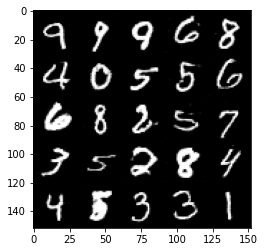

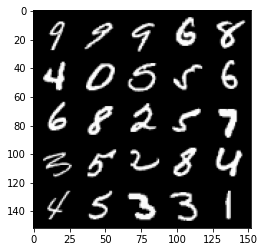

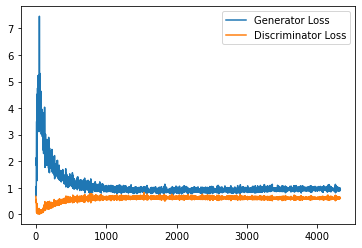

Step 87000: Generator loss: 0.956358025431633, discriminator loss: 0.6153498534560203


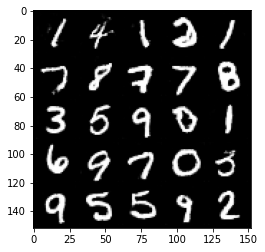

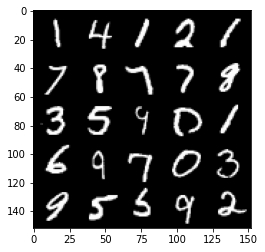

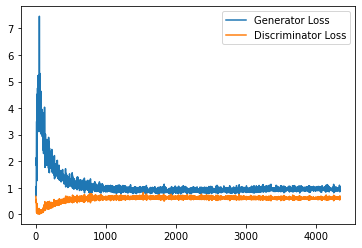

Step 87500: Generator loss: 0.9607234221696853, discriminator loss: 0.6119138481616974


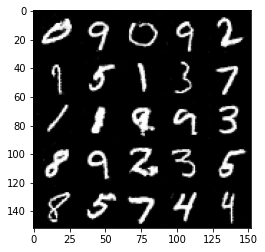

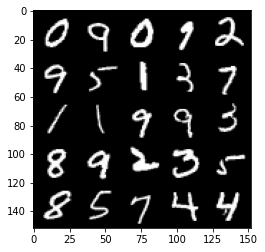

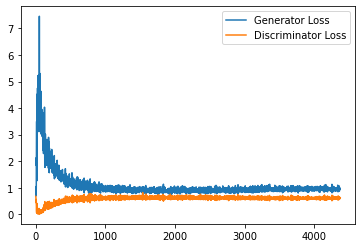

Step 88000: Generator loss: 0.9531010639667511, discriminator loss: 0.6170080091953277


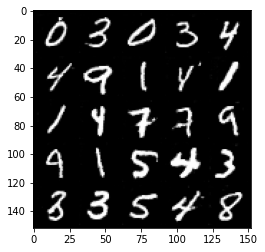

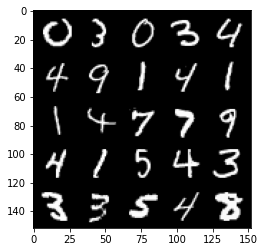

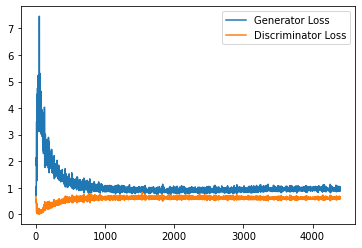

Step 88500: Generator loss: 0.9503737810850144, discriminator loss: 0.6101061576604843


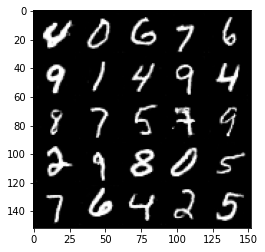

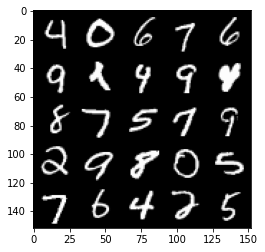

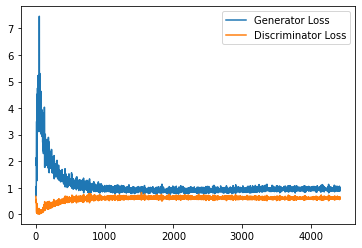

Step 89000: Generator loss: 0.9311711769104004, discriminator loss: 0.6144661772251129


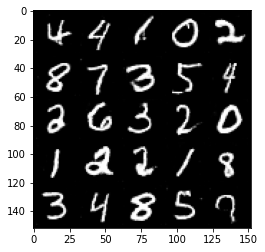

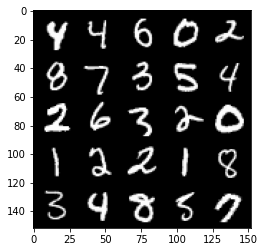

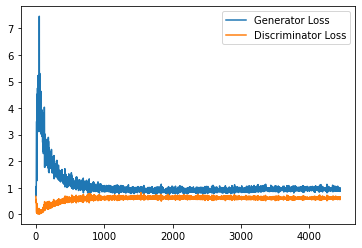

Step 89500: Generator loss: 0.9463206598758698, discriminator loss: 0.6143087564706803


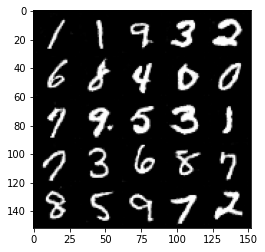

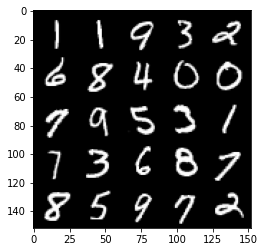

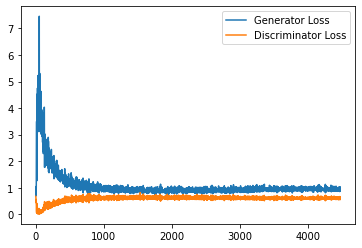

Step 90000: Generator loss: 0.946623856663704, discriminator loss: 0.611747085750103


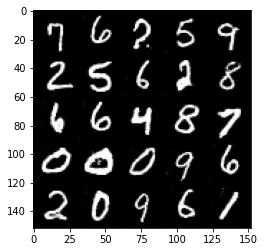

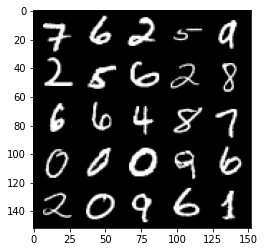

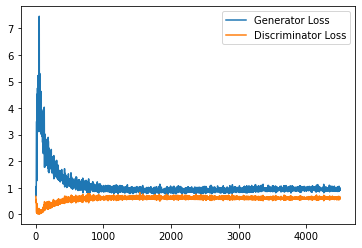

Step 90500: Generator loss: 0.9395206233263016, discriminator loss: 0.6155952968001366


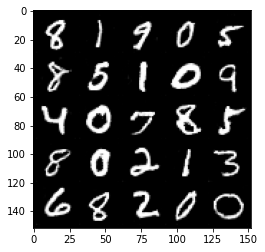

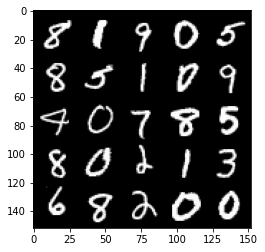

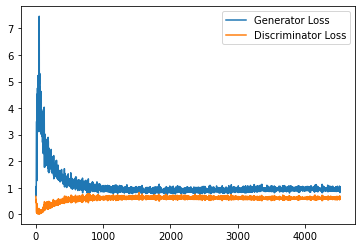

Step 91000: Generator loss: 0.9350997347831727, discriminator loss: 0.6150537210702897


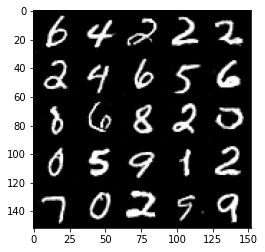

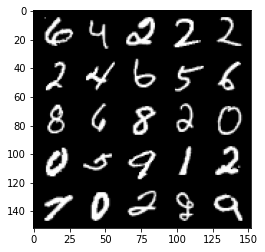

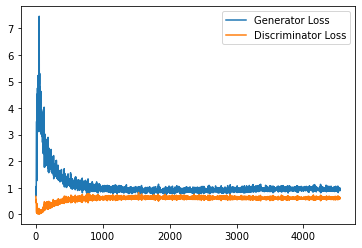

Step 91500: Generator loss: 0.9499957047700882, discriminator loss: 0.6143576290011405


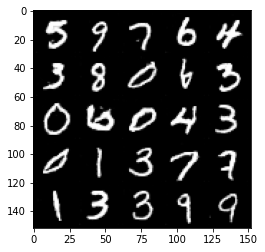

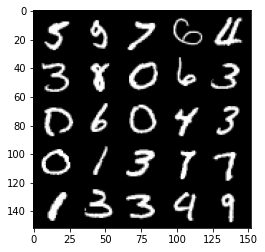

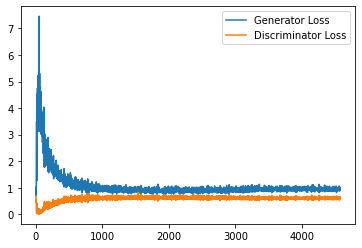

Step 92000: Generator loss: 0.9561985194683075, discriminator loss: 0.6146142727136612


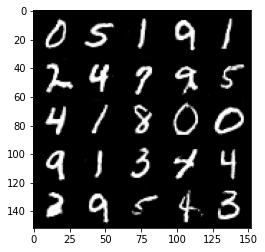

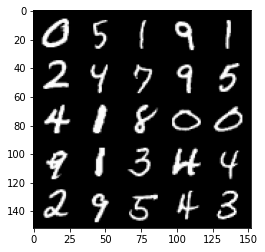

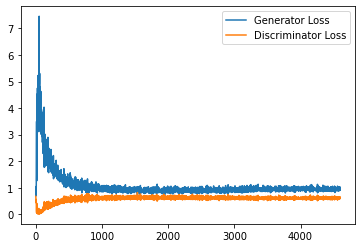

Step 92500: Generator loss: 0.9474175773859024, discriminator loss: 0.616686740398407


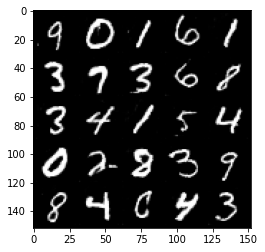

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()